In [1]:
import scanpy as sc
import scvelo as scv
import numpy as np
import pandas as pd
import loompy
import scanpy as sc
from glob import glob 
import os
import sys
import os
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri
import matplotlib.pyplot as plt
import scanpy as sc
import scvelo as scv
import numpy as np
import pandas as pd
import seaborn as sns
loompy.__version__
seurat = importr("Seurat")
scv.settings.set_figure_params('scvelo')
scv.settings.verbosity = 3
sc.logging.print_versions()
import pandas as pd
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
from rpy2.robjects import pandas2ri
from rpy2.robjects.conversion import localconverter
pandas2ri.activate()
import matplotlib
print(matplotlib.__version__)
from scanpy.plotting import _utils
from scanpy.plotting._tools.paga import paga
from scanpy.plotting._tools.scatterplots import _get_data_points

scanpy==1.4.5.dev199+gdd5b6f7 anndata==0.6.22.post1 umap==0.4.0 numpy==1.17.3 scipy==1.4.0rc1 pandas==0.25.3 scikit-learn==0.22 statsmodels==0.10.2 python-igraph==0.7.1 louvain==0.6.1
3.2.0rc1


In [2]:
!which python

/data/pinello/SHARED_SOFTWARE/anaconda3/envs/alvin_resvel/bin/python


In [3]:
def compute_velocity(loom, mito_prefix='MT-', cutoff=[5000, 0.15], norm=False):
    if isinstance(loom, str):
#         adata = scv.read(loom, cache=True) ## this is not working for Seurat output loom file
        adata= sc.read_loom(loom)
    elif len(loom) == 1:
        adata = scv.read(loom[0], cache=True)
    elif len(loom) > 1:
        adata = scv.read(loom[0], cache=True)
        adata2 = scv.read(loom[1], cache=True)
        adata = adata.concatenate(adata2, batch_key='library')
        
    adata.var_names_make_unique()
    cells = adata.obs.index
    print(adata.layers)
    if not norm:
        sc.pp.filter_cells(adata, min_genes=1000)
        sc.pp.filter_genes(adata, min_cells=5)
        mito_genes = adata.var_names.str.startswith(mito_prefix)
        # for each cell compute fraction of counts in mito genes vs. all genes
        # the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
        adata.obs['percent_mito'] = np.sum(
            adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
        # add the total counts per cell as observations-annotation to adata
        adata.obs['n_counts'] = adata.X.sum(axis=1).A1    
        sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
                     jitter=0.4, multi_panel=True)  
    #     print(adata.obs['percent_mito'])
        adata = adata[adata.obs['n_genes'] < cutoff[0], :]
        adata = adata[adata.obs['percent_mito'] < cutoff[1], :]     
        
    scv.pp.filter_and_normalize(adata, min_shared_counts=0, n_top_genes=3000)    
    scv.pp.moments(adata, n_pcs=20, n_neighbors=30)
  #  sc.pp.regres_out(adata, ['n_counts', 'percent_mito'])
  #  sc.pp.scale(adata, max_value=10)
    sc.tl.umap(adata)
    sc.tl.louvain(adata, resolution=0.8)
    scv.tl.velocity(adata, mode='stochastic')
    scv.tl.velocity_graph(adata)
    scv.tl.velocity_embedding(adata, basis='umap')
    scv.tl.rank_velocity_genes(adata, match_with='clusters', resolution=0.8)
    scv.tl.terminal_states(adata, groupby='velocity_clusters')
    scv.tl.velocity_pseudotime(adata, groupby='velocity_clusters')
    select = np.in1d(cells, adata.obs.index.values)
    return adata, select

def plot_velocity(adata, genes):
    scv.pl.velocity_embedding_stream(adata, basis='umap', color=['velocity_clusters'])
    scv.pl.velocity_embedding(adata, basis='umap', dpi=200, arrow_size=1.5)
    scv.pl.velocity_embedding_grid(adata, basis='umap', 
                                   arrow_size=1.5, color=genes,
                                   layer=['velocity', 'spliced'])
    scv.pl.scatter(adata, color=['velocity_pseudotime', 'root_cells', 'end_points'], size=100)
    scv.pl.velocity(adata, var_names=genes, ncols=1, colorbar=True)
    scv.pl.velocity_graph(adata)

In [9]:
from anndata import AnnData

## https://romanhaa.github.io/blog/paga_to_r/
def paga_compare(
    adata: AnnData,
    ax=None,
    basis=None,
    edges=False,
    color=None,
    alpha=None,
    groups=None,
    components=None,
    projection='2d',
    legend_loc='on data',
    legend_fontsize=None,
    legend_fontweight='bold',
    legend_fontoutline=None,
    color_map=None,
    palette=None,
    frameon=False,
    size=None,
    title=None,
    right_margin=None,
    left_margin=0.05,
    show=None,
    save=None,
    title_graph=None,
    groups_graph=None,
    **paga_graph_params,
):
    """\
    Scatter and PAGA graph side-by-side.
    Consists in a scatter plot and the abstracted graph. See
    :func:`~scanpy.pl.paga` for all related parameters.
    See :func:`~scanpy.pl.paga_path` for visualizing gene changes along paths
    through the abstracted graph.
    Additional parameters are as follows.
    Parameters
    ----------
    adata
        Annotated data matrix.
    kwds_scatter
        Keywords for :func:`~scanpy.pl.scatter`.
    kwds_paga
        Keywords for :func:`~scanpy.pl.paga`.
    Returns
    -------
    A list of :class:`~matplotlib.axes.Axes` if `show` is `False`.
    """
    if color is None:
        color = adata.uns['paga']['groups']
    suptitle = None  # common title for entire figure
    if title_graph is None:
        suptitle = color if title is None else title
        title, title_graph = '', ''
    if basis is None:
        if 'X_draw_graph_fa' in adata.obsm.keys():
            basis = 'draw_graph_fa'
        elif 'X_umap' in adata.obsm.keys():
            basis = 'umap'
        elif 'X_tsne' in adata.obsm.keys():
            basis = 'tsne'
        elif 'X_draw_graph_fr' in adata.obsm.keys():
            basis = 'draw_graph_fr'
        else:
            basis = 'umap'

    if 'labels' in paga_graph_params:
        labels = paga_graph_params.pop('labels')
    else:
        labels = groups_graph
    if legend_fontsize is not None:
        paga_graph_params['fontsize'] = legend_fontsize
    if legend_fontweight is not None:
        paga_graph_params['fontweight'] = legend_fontweight
    if legend_fontoutline is not None:
        paga_graph_params['fontoutline'] = legend_fontoutline
    sc.pl.umap(adata, ax=ax, show=False)
#     if 'pos' not in paga_graph_params:
#         if color == adata.uns['paga']['groups']:
#             paga_graph_params['pos'] = _utils._tmp_cluster_pos
#         else:
#             paga_graph_params['pos'] = adata.uns['paga']['pos'] 
    categories = list(adata.obs['clusters'].cat.categories)
    all_pos = np.zeros((len(categories), 2))
    datapoints, components = _get_data_points(adata, 'umap', '2d', 'all')
    for ilabel, label in enumerate(categories):
        _scatter = datapoints[0][adata.obs['clusters'] == label, :]
        x_pos, y_pos = np.median(_scatter, axis=0)
        all_pos[ilabel] = [x_pos, y_pos]
        if mast111.obs.index[0].split('_')[1] == 'MSK82489':
            if label == 'G2M':
                all_pos[ilabel] = [all_pos[ilabel][0]*4.25, all_pos[ilabel][1]*1.2]    
    paga_graph_params['pos'] = all_pos
    
    paga(
        adata,
        ax=ax,
        show=False,
        save=False,
        title=title_graph,
        labels=labels,
        colors=color,
        frameon=frameon,
        node_size_scale=3, 
        **paga_graph_params,
    )
    _utils.savefig_or_show('paga_compare', show=show, save=save)
    if show == False: return ax

In [94]:
mast111.obs.index[0].split('_')[1]

'MSK82489'

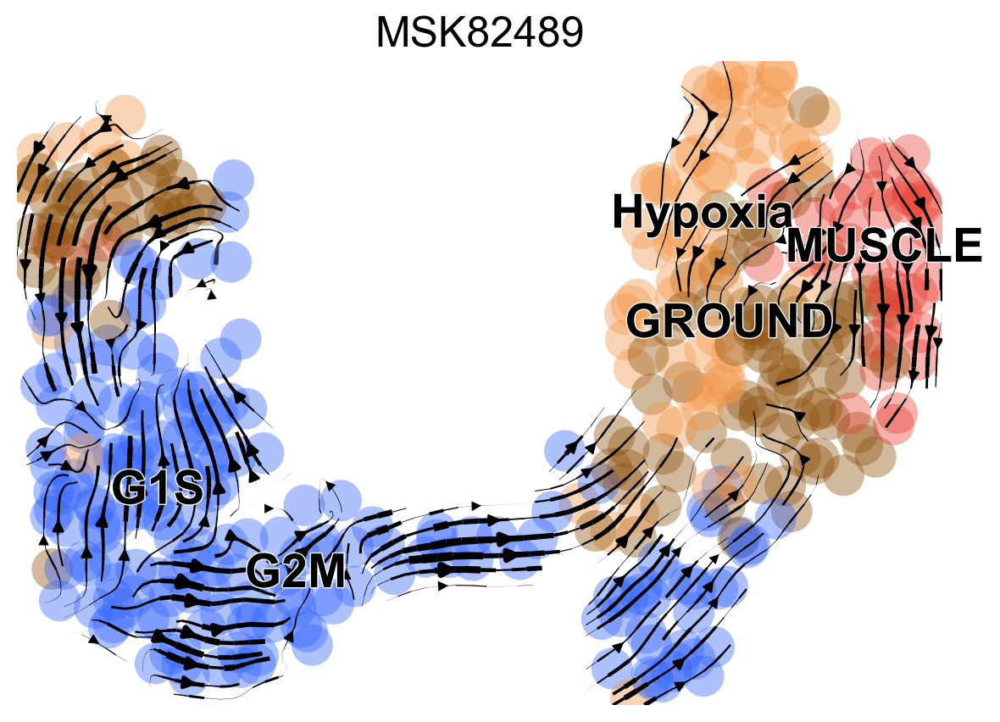

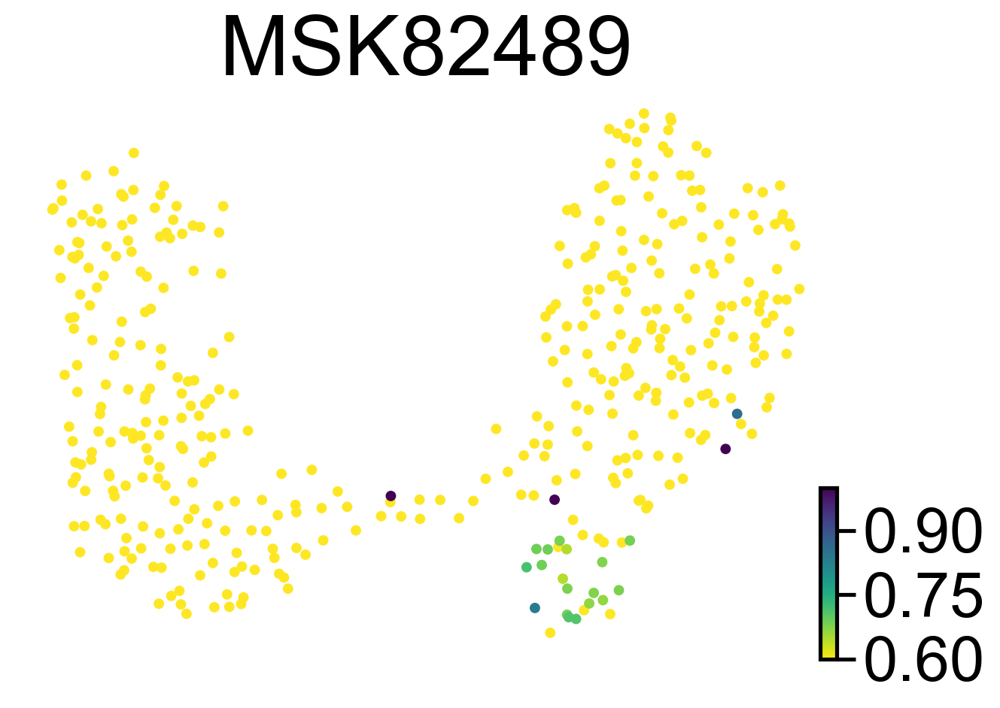

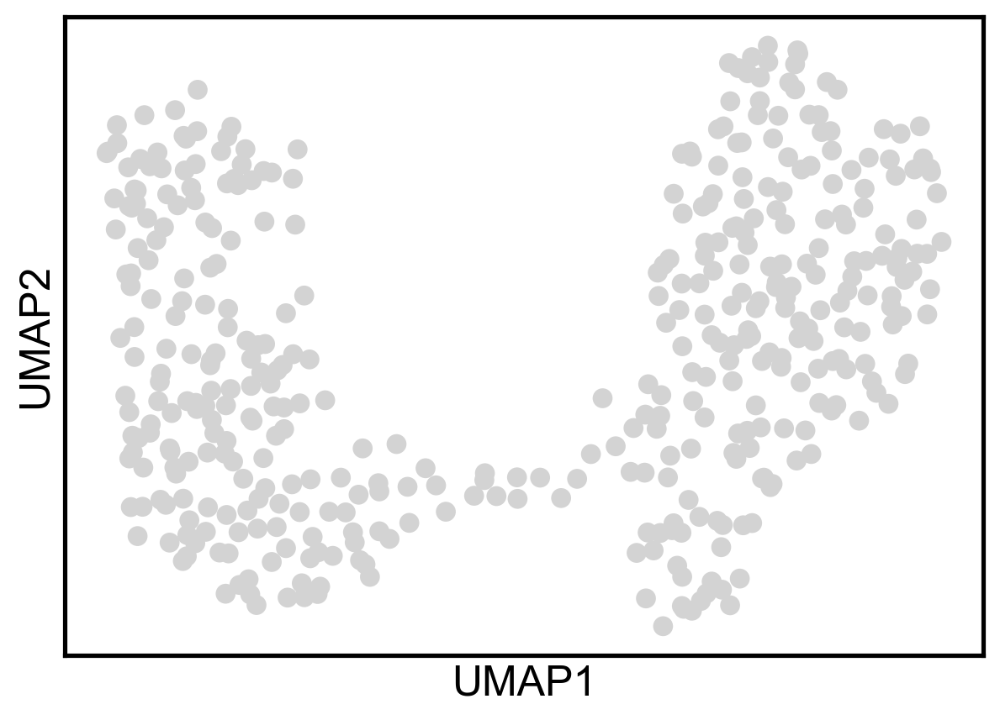

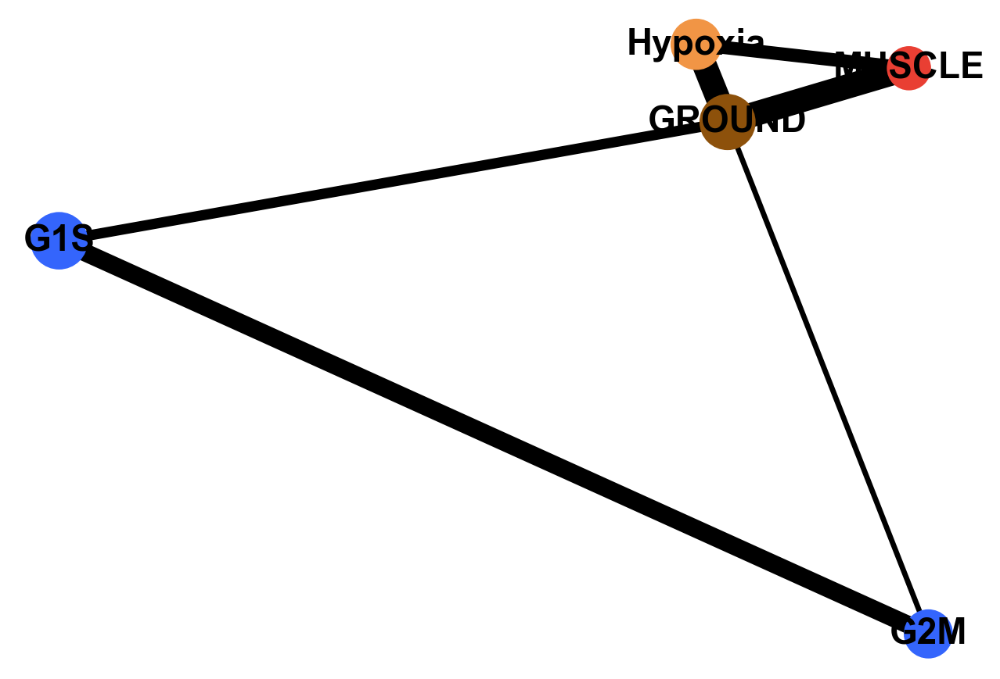

In [95]:
scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                 legend_fontsize=20, alpha=.4, show=True,
                                 linewidth=2)
scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
               size=100, legend_fontsize=40, fontsize=40,        
               vmin=0.6, vmax=1.0, 
               show=False)
paga_compare(mast111, title='', legend_loc='none', threshold=0.2, 
                 right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
                 legend_fontsize=None, frameon=False, show=False)

../results/MAST35_velocity.h5ad


... storing 'clusters' as categorical


0 GROUND #8D510B
1 Histones #F769A1
2 GROUND #8D510B
3 G2M #3465FC
4 Histones #F769A1
5 G1S #3465FC
6 Hypoxia #F19545
7 G2M #3465FC
8 INTERFERON #418107
9 G2M #3465FC
Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON'], dtype='object')


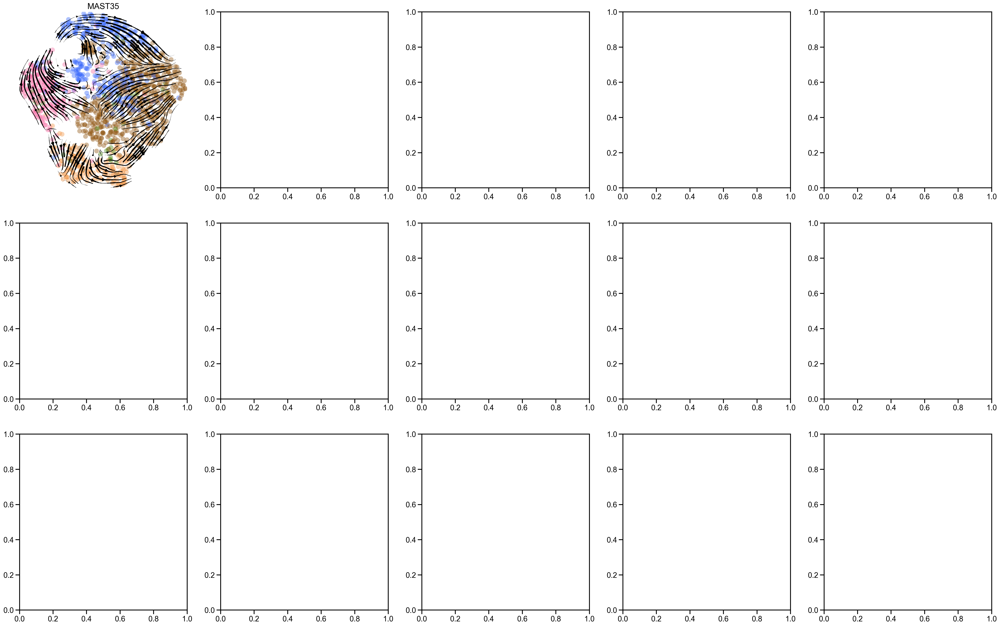

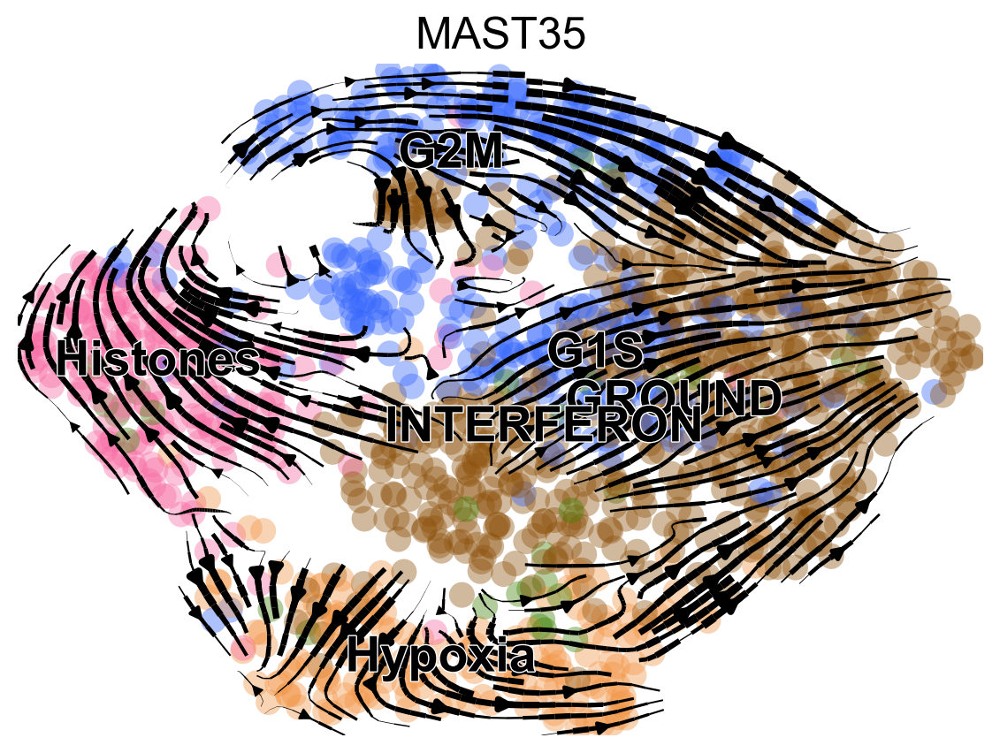

../results/MAST85_velocity.h5ad


... storing 'clusters' as categorical


0 GROUND #8D510B
1 G1S #3465FC
2 Histones #F769A1
3 G2M #3465FC
4 G1S #3465FC
5 G2M #3465FC
6 Hypoxia #F19545
7 INTERFERON #418107
8 UNASSIGNED #F2F2F2
Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON',
       'UNASSIGNED'],
      dtype='object')


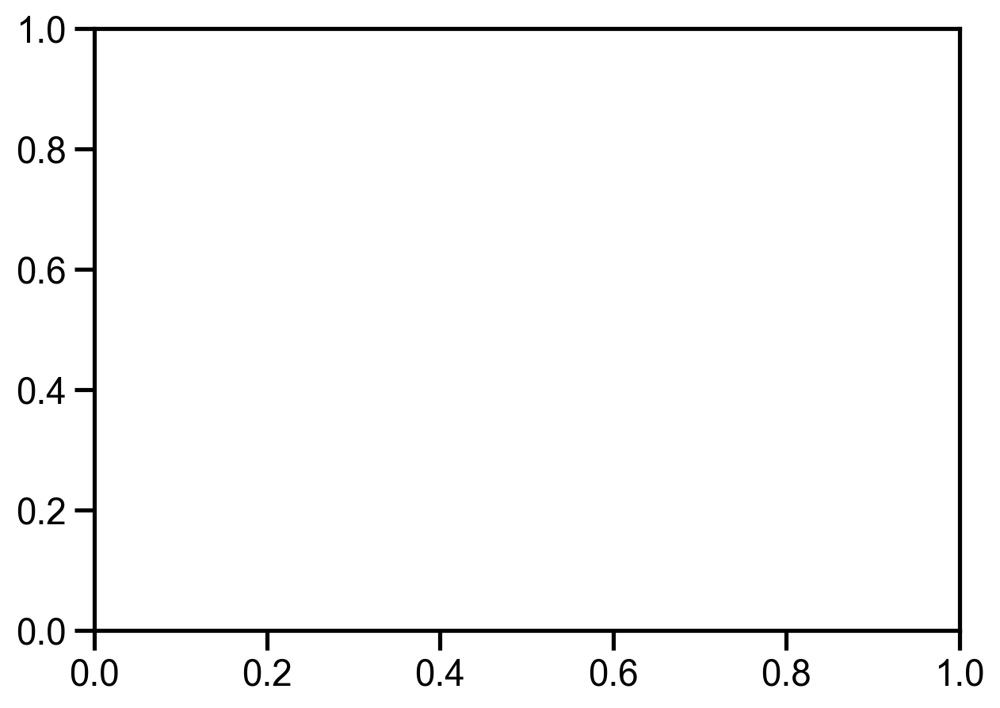

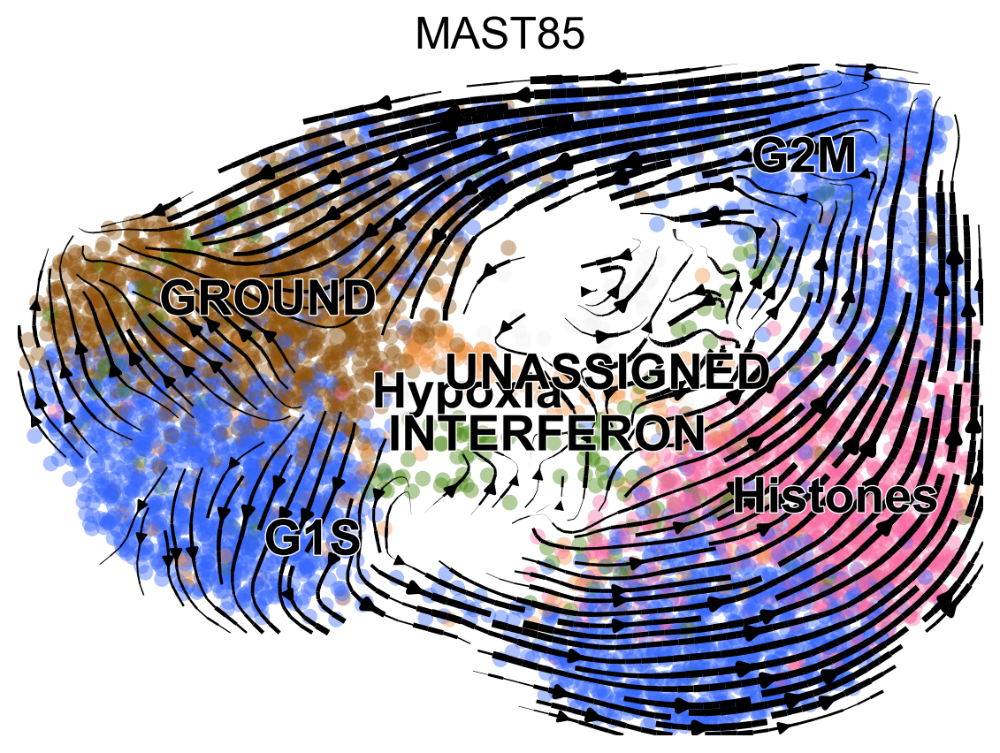

../results/MAST139_velocity.h5ad


... storing 'clusters' as categorical


0 G1S #3465FC
1 Hypoxia #F19545
2 G2M #3465FC
3 EMT #672366
4 GROUND #8D510B
5 EMT #672366
6 MUSCLE #E93F33
7 EMT #672366
8 INTERFERON #418107
9 EMT #672366
Index(['EMT', 'G1S', 'G2M', 'GROUND', 'Hypoxia', 'INTERFERON', 'MUSCLE'], dtype='object')


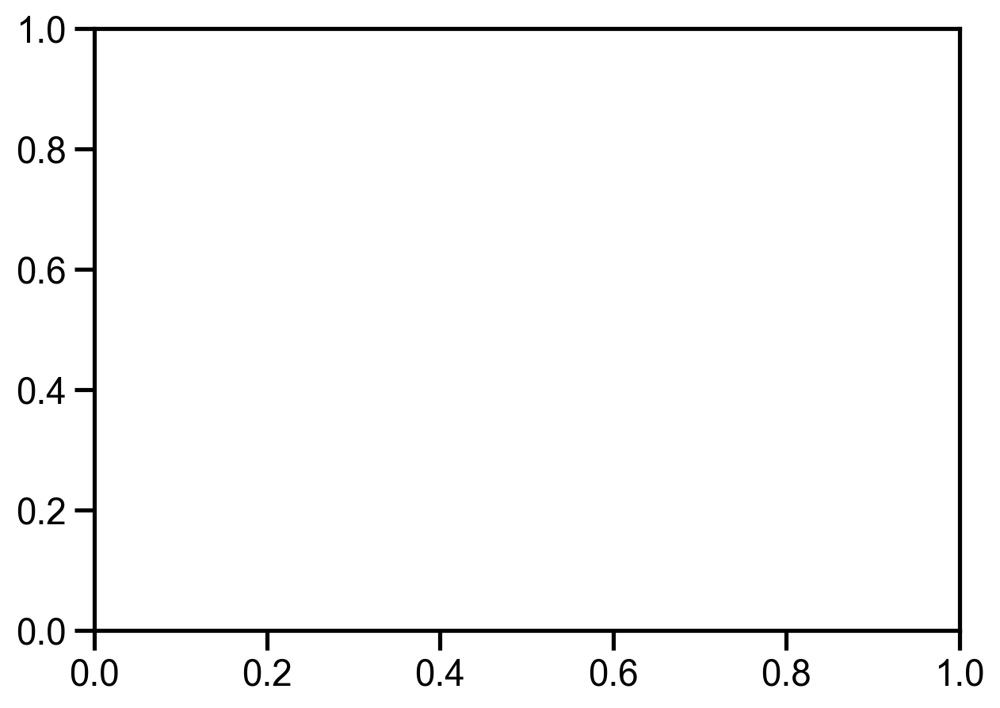

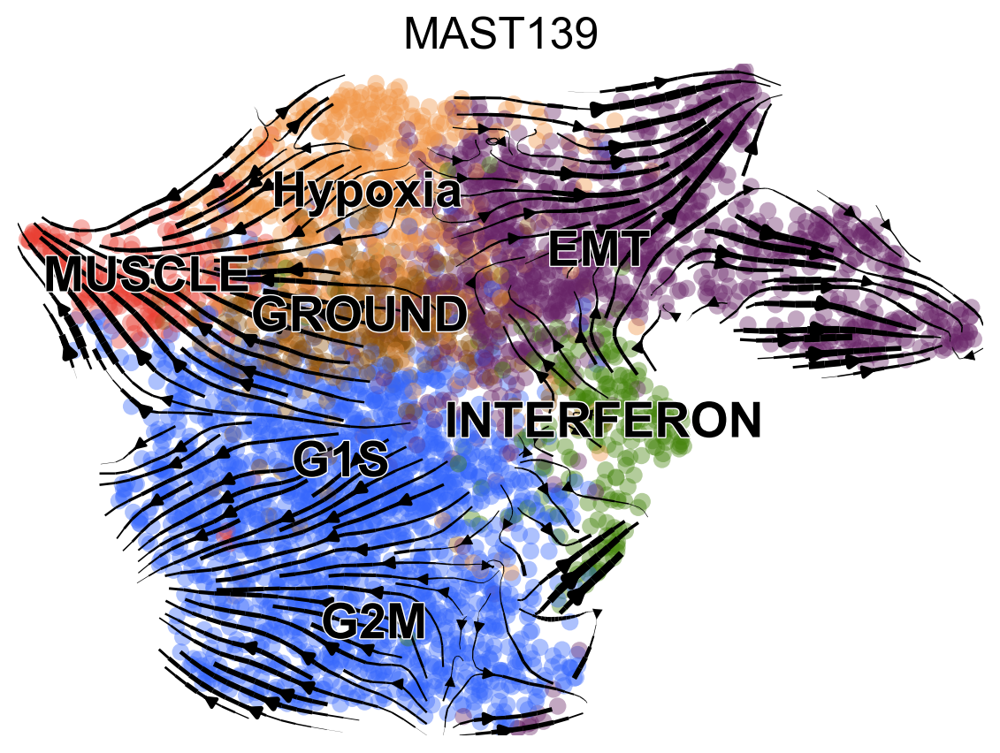

../results/MAST95_velocity.h5ad


... storing 'clusters' as categorical


0 GROUND #8D510B
1 Hypoxia #F19545
2 MUSCLE #E93F33
3 G1S #3465FC
4 G1S #3465FC
5 G2M #3465FC
6 UNASSIGNED #F2F2F2
7 UNASSIGNED #F2F2F2
8 UNASSIGNED #F2F2F2
9 Hypoxia #F19545
10 MUSCLE #E93F33
Index(['G1S', 'G2M', 'GROUND', 'Hypoxia', 'MUSCLE', 'UNASSIGNED'], dtype='object')


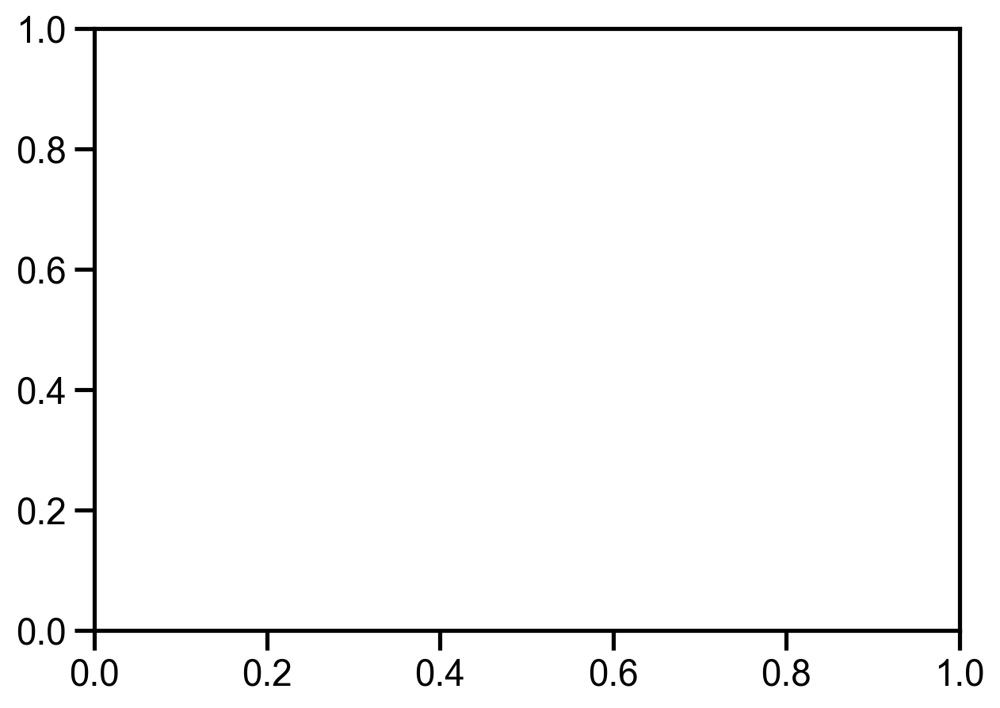

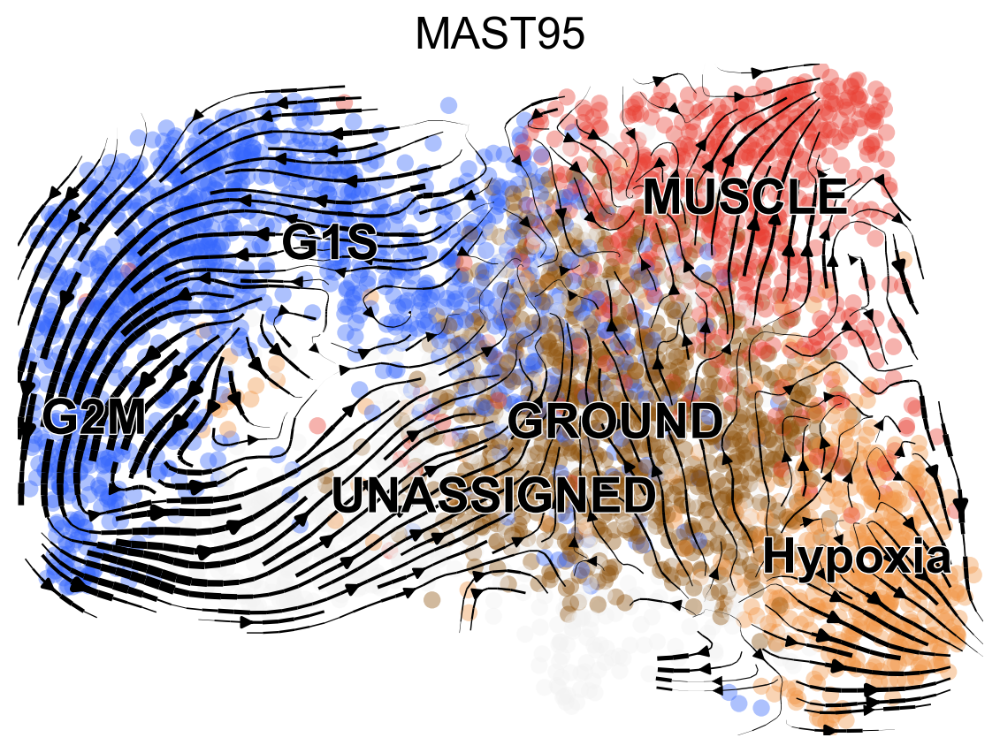

../results/MSK82489_velocity.h5ad


... storing 'clusters' as categorical


0 GROUND #8D510B
1 G1S #3465FC
2 G1S #3465FC
3 MUSCLE #E93F33
4 Hypoxia #F19545
5 G2M #3465FC
6 G2M #3465FC
Index(['G1S', 'G2M', 'GROUND', 'Hypoxia', 'MUSCLE'], dtype='object')


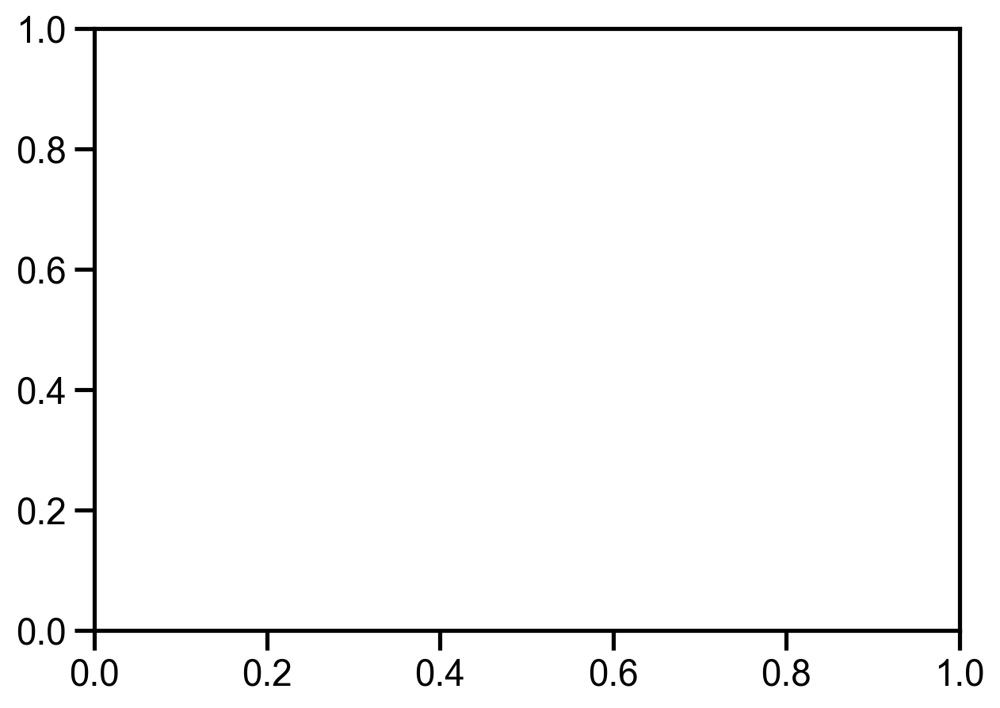

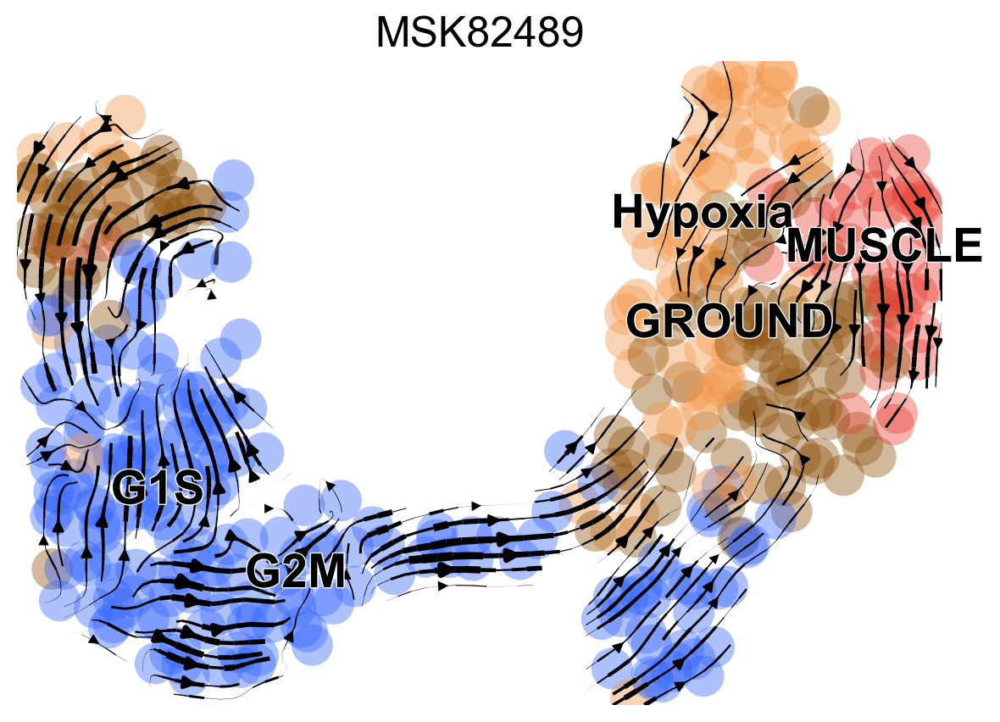

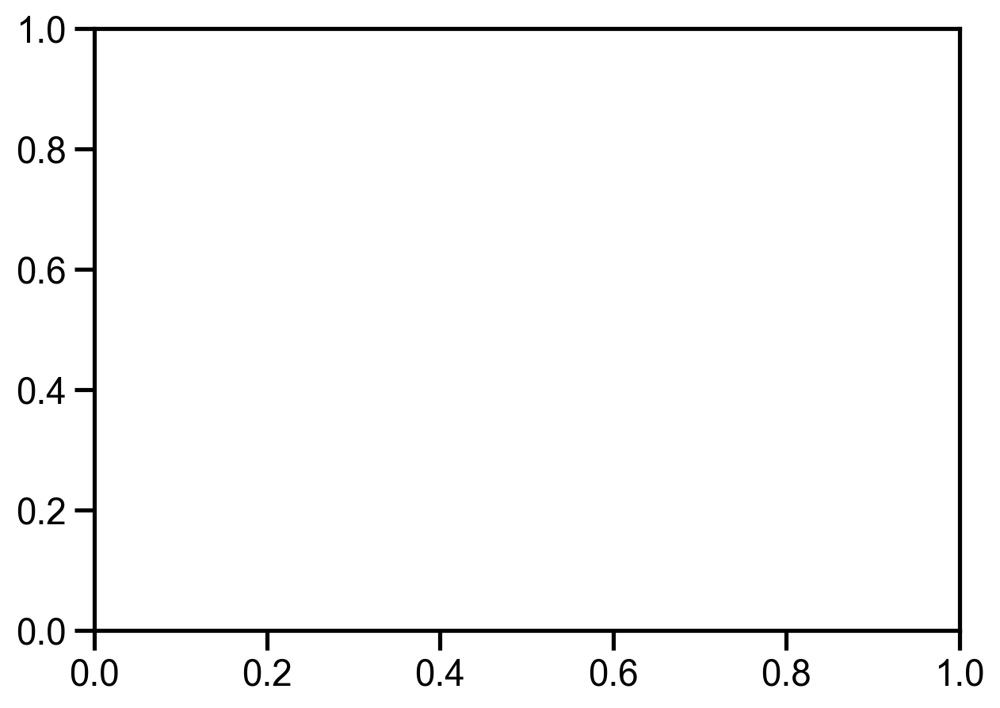

In [100]:
label_stat = {}
fig, axes = plt.subplots(3, 5)
fig.set_size_inches(38, 24)
col = 0
row = 0
degrees = []

for g in ['../results/MAST35_velocity.h5ad', 
          '../results/MAST85_velocity.h5ad', 
          '../results/MAST139_velocity.h5ad',
          '../results/MAST95_velocity.h5ad', 
          '../results/MSK82489_velocity.h5ad']:
    mast111 = sc.read(g)
    print(g)
    label = os.path.basename(g).split('_')[0]
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
#     meta = pandas2ri.ri2py(test_seu.slots['meta.data'])
    selection = np.load(f'../results/{label}_velocity.npy')
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    metalabels = np.array(["GROUND", "Hypoxia", "EMT", "G1S", "UNASSIGNED", "G2M", 
                           "MUSCLE", "INTERFERON", "PROLIF", "Histones"])
    metacolors = np.array(["#8D510B", "#F19545", "#672366", "#3465FC", "#F2F2F2",
                           "#3465FC", "#E93F33", "#418107", "#3465FC", "#F769A1"])
    
    colortab = pd.read_table('color_table.xls')    
    color_dict = {}
    color_dict2 = {}
    metalabels_dict = {}
    for i, m in enumerate(metalabels):
        metalabels_dict[m] = i
    colors = np.array([ metalabels_dict[m] for m in colortab.loc[:, label].dropna() ])
    for i, j, c in zip(range(len(colortab.loc[:, label].dropna())), 
                       colortab.loc[:, label].dropna(), 
                       metacolors[colors]):
        print(i, j, c)
        color_dict[str(i)] = j
        color_dict2[j] = c
    mast111.obs['clusters'] = clusters.values.map(color_dict)
    sc.tl.paga(mast111)
    sc.tl.paga(mast111, groups='clusters', use_rna_velocity=False) ## use_rna_velocity=True is buggy and unstable...!!!!!

    mast111.uns['clusters_colors'] = [color_dict2[c] for c in mast111.obs['clusters'].cat.categories]
    
    print(mast111.obs['clusters'].cat.categories)
    if col == 5:
        row = 1
        col = 0
#         break
    scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                     legend_fontsize=20, alpha=.4, show=False,
                                     legend_loc='none',
                                     linewidth=2,
                                     ax=axes[row, col])
    scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                     legend_fontsize=20, alpha=.4, show=True,
                                     linewidth=2)    
    scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
                   size=100, legend_fontsize=40, fontsize=40,        
                   vmin=0.6, vmax=1.0, 
                   show=False, ax=axes[row+1, col])
    paga_compare(mast111, title='', legend_loc='none', threshold=0.1, 
                 right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
                 legend_fontsize=None, frameon=False, show=False, ax=axes[row+2, col])
    col += 1
    
for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(25)

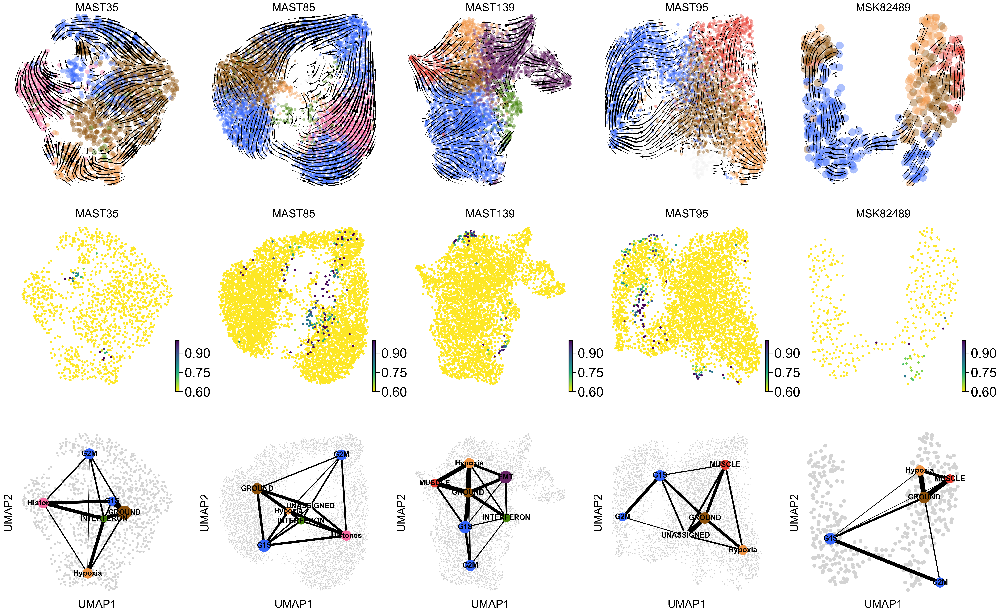

In [101]:
fig

In [102]:
fig.savefig("Fig4A.png", dpi=200)

../results/MAST85-1cell_velocity.h5ad


... storing 'clusters' as categorical


Index(['EMT', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON'], dtype='object')


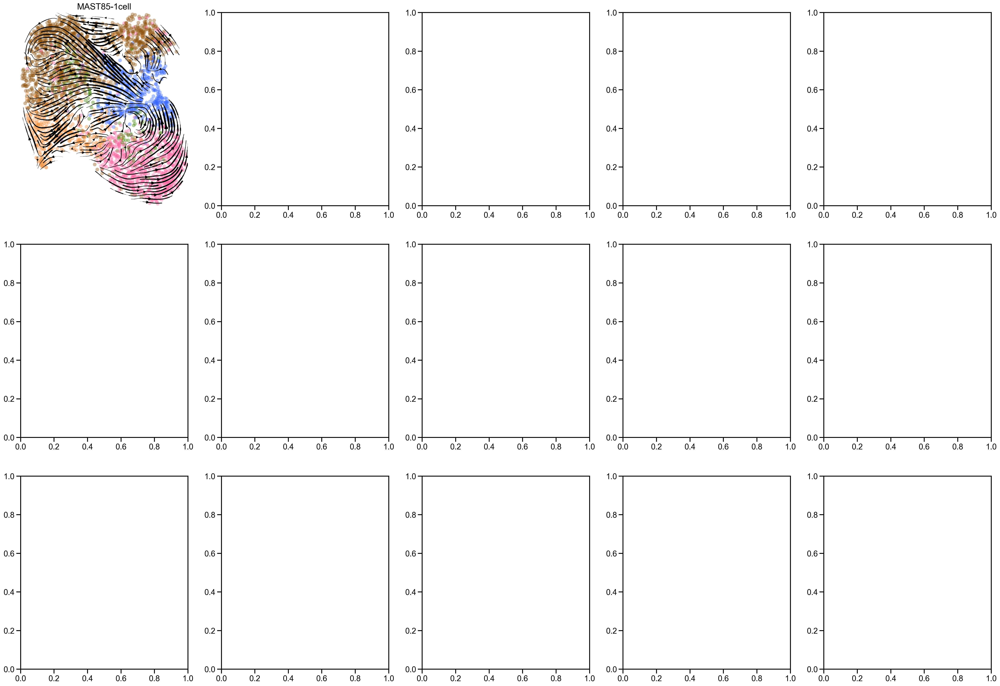

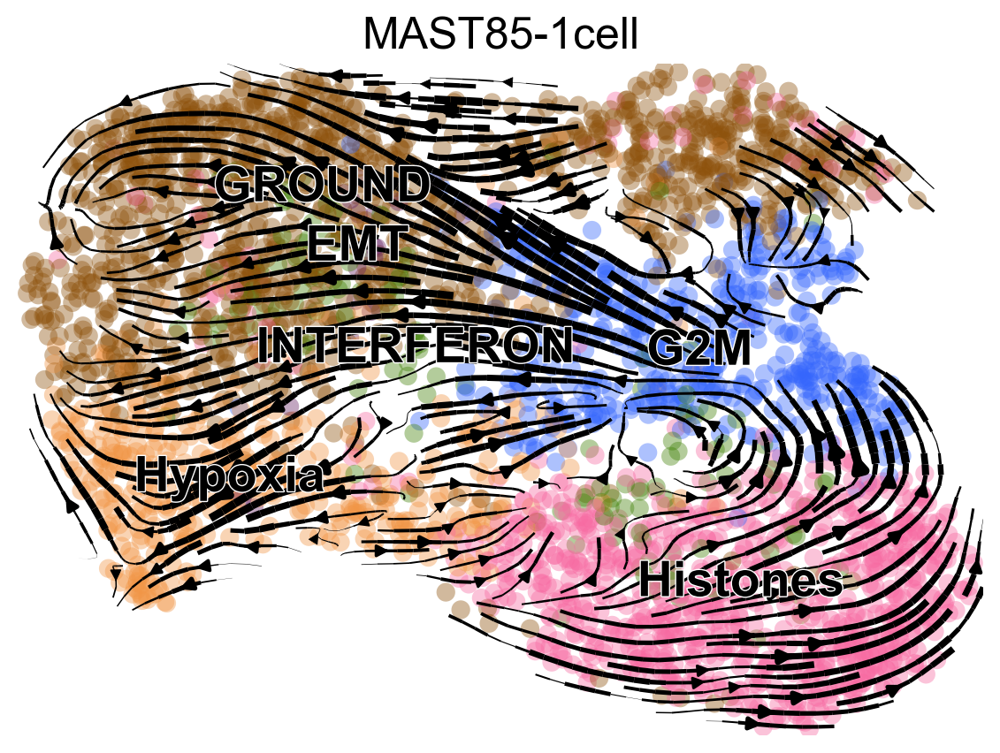

../results/MAST39_velocity.h5ad


... storing 'clusters' as categorical


Index(['EMT', 'G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON',
       'PROLIF'],
      dtype='object')


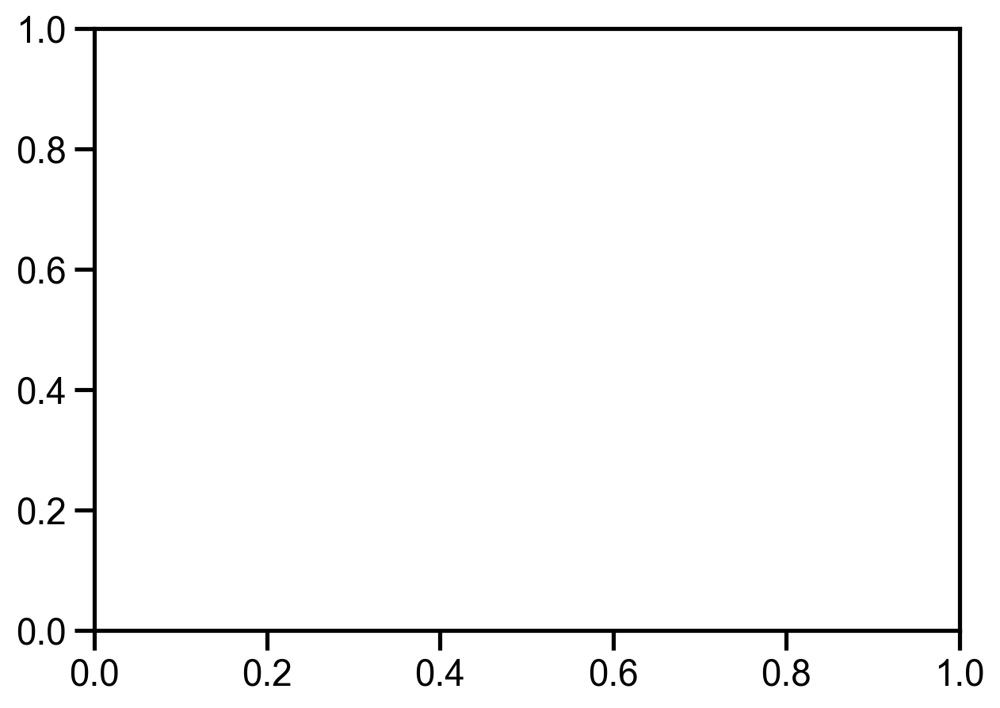

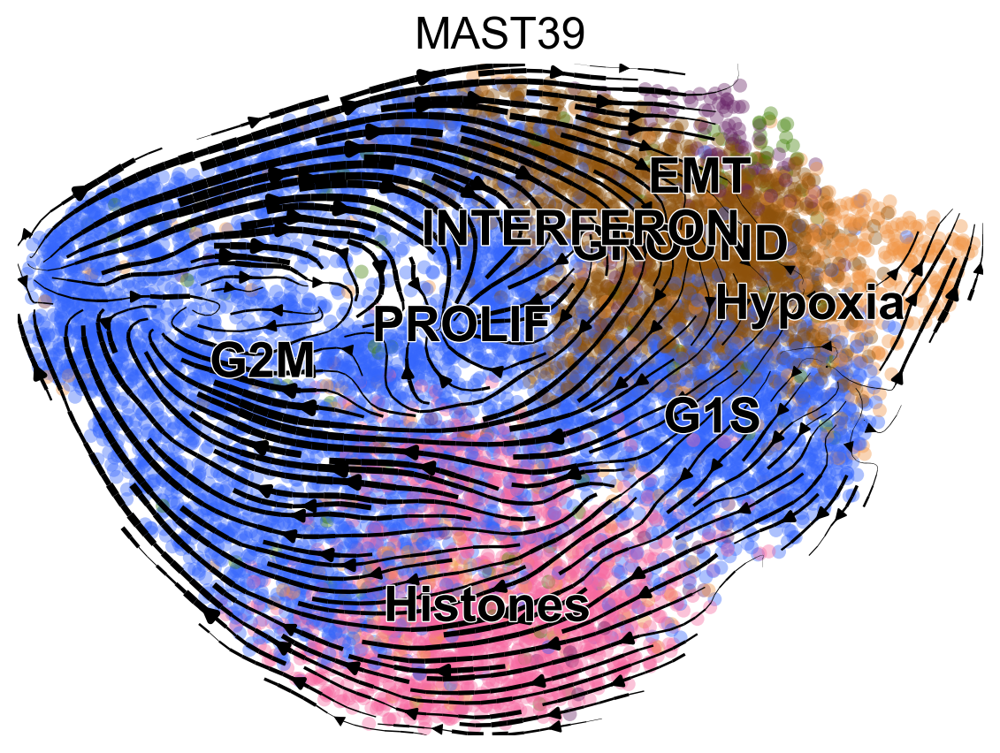

../results/RH74_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON'], dtype='object')


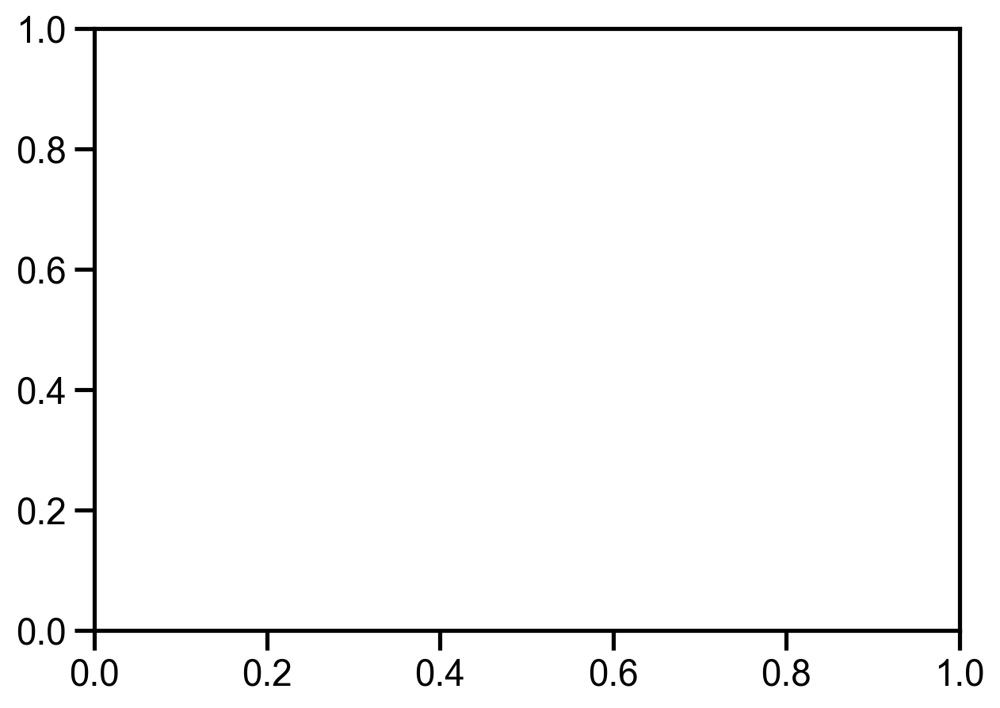

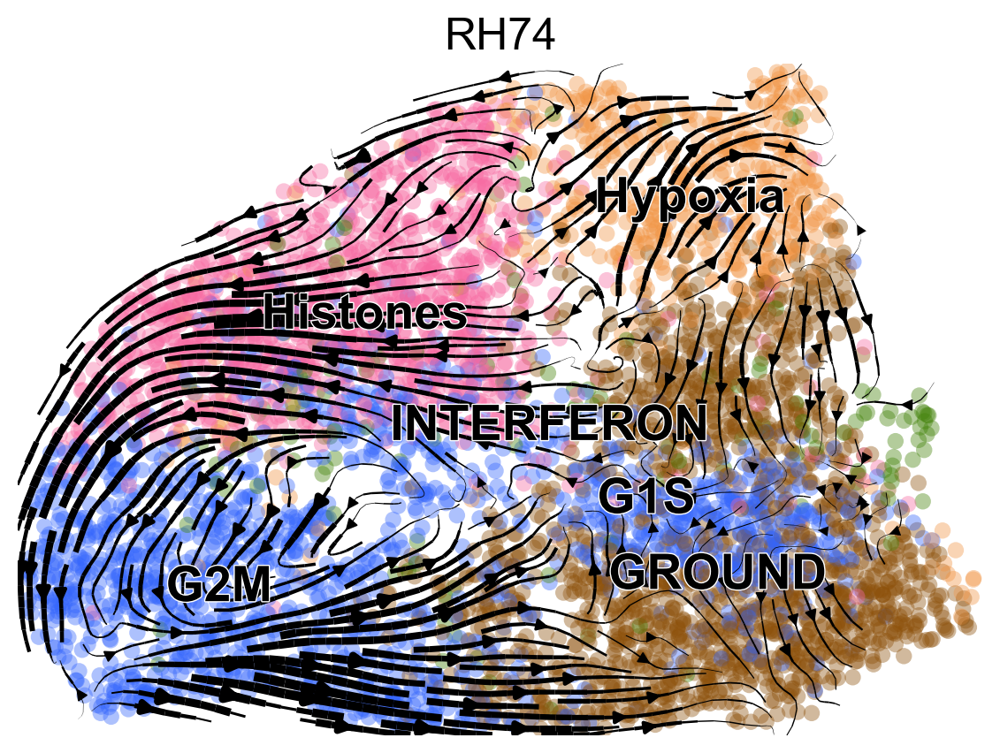

../results/RH74-10cells_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON',
       'UNASSIGNED'],
      dtype='object')


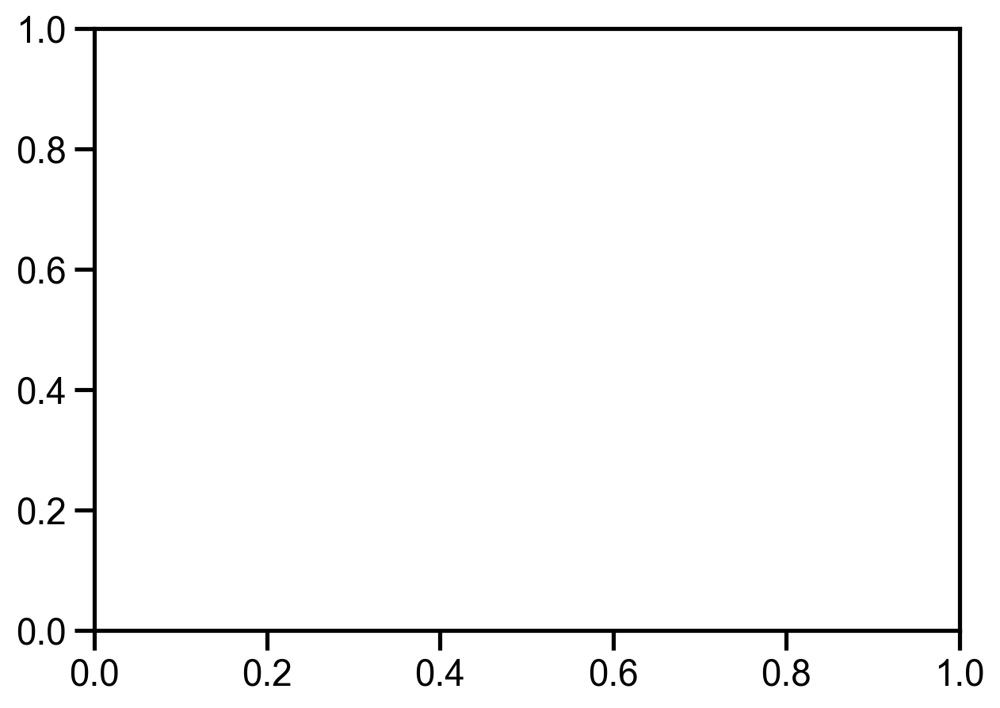

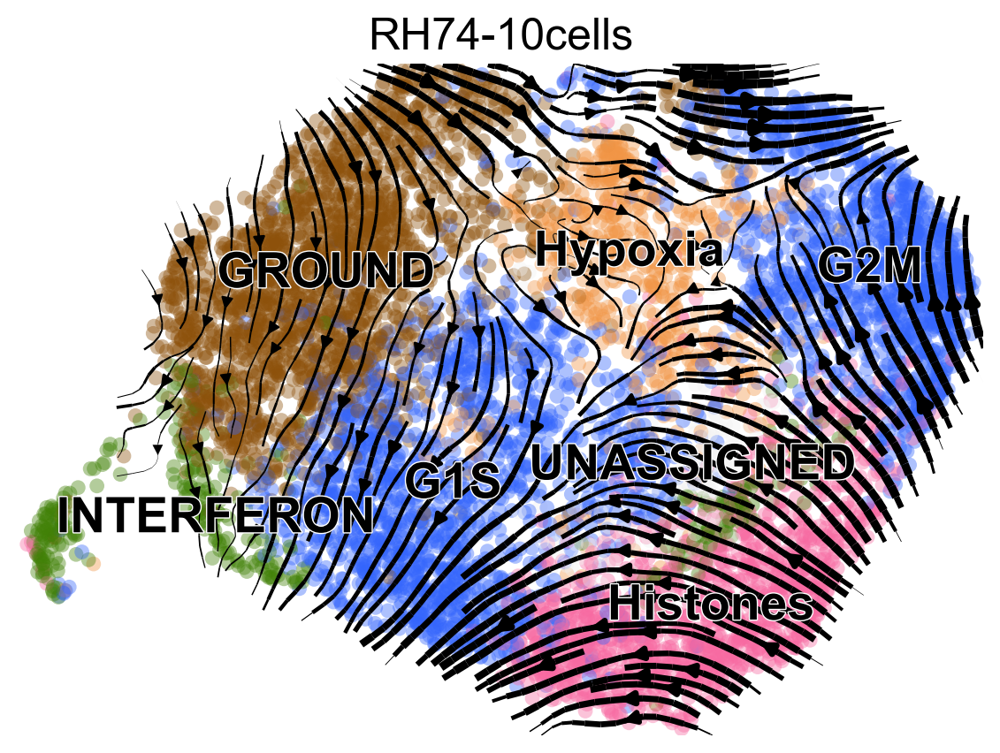

../results/MAST111_velocity.h5ad


... storing 'clusters' as categorical


Index(['EMT', 'G1S', 'G2M', 'GROUND', 'Hypoxia', 'MUSCLE', 'PROLIF',
       'UNASSIGNED'],
      dtype='object')


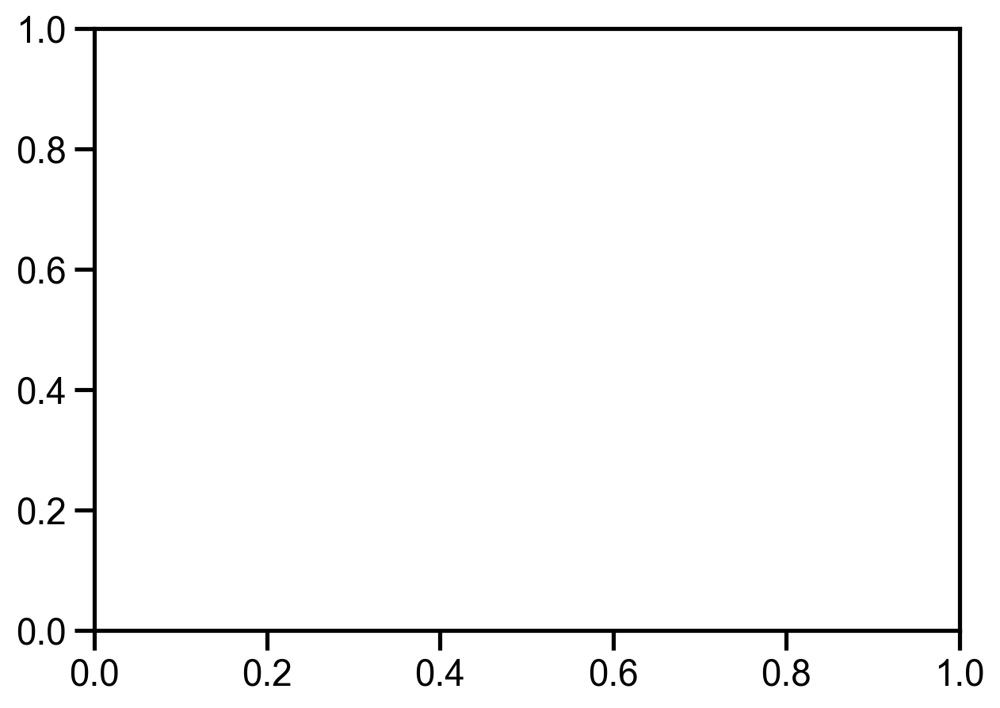

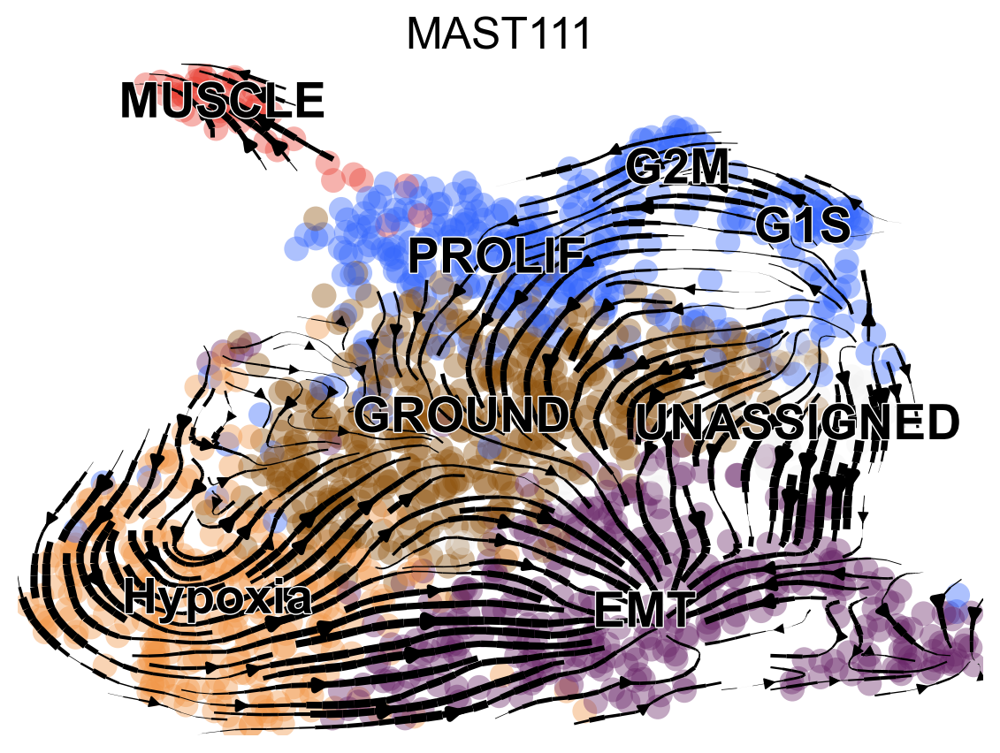

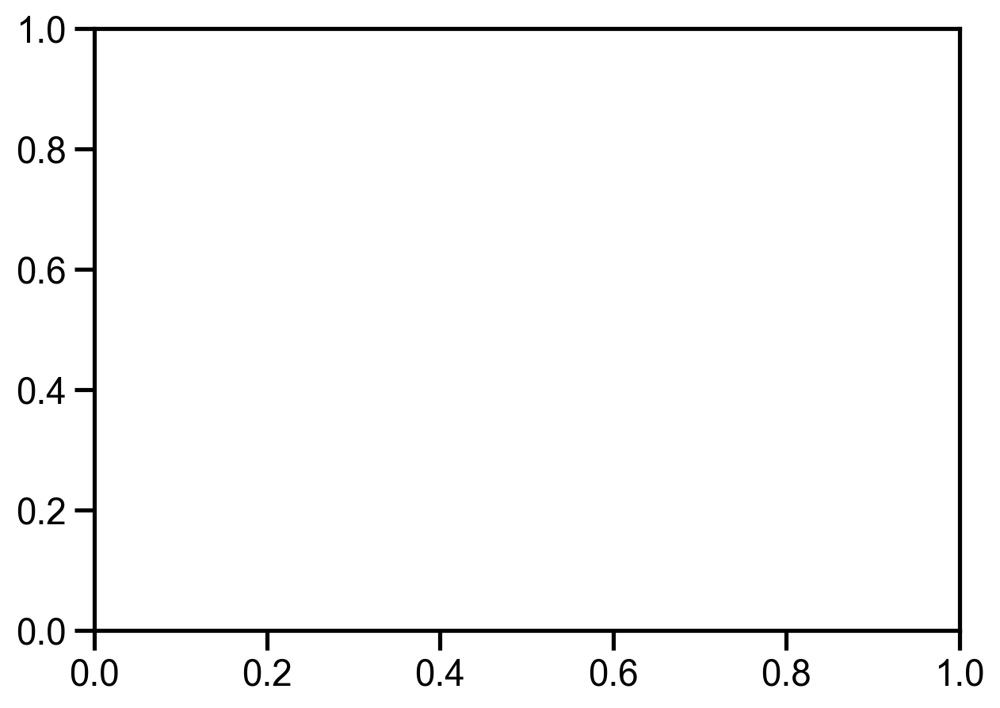

In [53]:
import scipy, igraph

degrees = []
label_stat = {}
fig, axes = plt.subplots(3, 5)
fig.set_size_inches(36, 25)
col = 0
row = 0
for g in ['../results/MAST85-1cell_velocity.h5ad',
          '../results/MAST39_velocity.h5ad',
          '../results/RH74_velocity.h5ad', 
          '../results/RH74-10cells_velocity.h5ad', 
          '../results/MAST111_velocity.h5ad']:
    mast111 = sc.read(g)
    print(g)
    label = os.path.basename(g).split('_')[0]
    
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
#     meta = pandas2ri.ri2py(test_seu.slots['meta.data'])    
    selection = np.load(f'../results/{label}_velocity.npy')
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    
    metalabels = np.array(["GROUND", "Hypoxia", "EMT", "G1S", "UNASSIGNED", "G2M", 
                           "MUSCLE", "INTERFERON", "PROLIF", "Histones"])
    metacolors = np.array(["#8D510B", "#F19545", "#672366", "#3465FC", "#F2F2F2",
                           "#3465FC", "#E93F33", "#418107", "#3465FC", "#F769A1"])
    
    colortab = pd.read_table('color_table.xls')    
    color_dict = {}
    color_dict2 = {}
#     for i, j, c in zip(range(len(colortab.loc[:, label].dropna())), 
#                        colortab.loc[:, label].dropna(), 
#                        metacolors[pd.match(colortab.loc[:, label].dropna(), metalabels)]):
    metalabels_dict = {}
    for i, m in enumerate(metalabels):
        metalabels_dict[m] = i
    colors = np.array([ metalabels_dict[m] for m in colortab.loc[:, label].dropna() ])
    for i, j, c in zip(range(len(colortab.loc[:, label].dropna())), 
                       colortab.loc[:, label].dropna(), 
                       metacolors[colors]):
        color_dict[str(i)] = j
        color_dict2[j] = c

    mast111.obs['clusters'] = clusters.values.map(color_dict)
    sc.tl.paga(mast111)
    sc.tl.paga(mast111, groups='clusters', use_rna_velocity=False)
    mast111.uns['clusters_colors'] = [color_dict2[c] for c in mast111.obs['clusters'].cat.categories]
    print(mast111.obs['clusters'].cat.categories)
    if col == 10:
        row = 1
        col = 0
#         break
#     scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
#                                      legend_fontsize=20, alpha=.4, show=False,
#                                      arrow_color='gray',
#                                      linewidth=2, legend_loc=None,
#                                      ax=axes[row, col])
#     scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
#                    size=100, legend_fontsize=40,
#                    show=False, ax=axes[row+1, col])
# #     sc.pl.paga(mast111, color=['clusters'], edge_width_scale=0.5, 
# #                layout='fr', random_state=0, frameon=False, title=label,
# #                fontsize=20, threshold=0.1, show=False, ax=axes[row+2, col])
#     paga_compare(
#         mast111, title='',  threshold=0.1, right_margin=0.2, size=20, edge_width_scale=1,
#         legend_fontsize=20, fontsize=20, frameon=False, show=False, ax=axes[row+2, col])
    
    scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                     legend_fontsize=20, alpha=.4, show=False,
                                     legend_loc='none',
                                     linewidth=2,
                                     ax=axes[row, col])
    scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                     legend_fontsize=20, alpha=.4, show=True,
                                     linewidth=2)   
    
    if g != '../results/RH74-10cells_velocity.h5ad':
        scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
                       size=100, legend_fontsize=40, fontsize=40,        
                       vmin=0.6, vmax=1.0, 
                       show=False, ax=axes[row+1, col])
    else:
        scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
                       size=100, legend_fontsize=40, fontsize=40,        
                       vmin=0, vmax=1.0, 
                       show=False, ax=axes[row+1, col])        
# #     sc.pl.paga(mast111, color=['clusters'], edge_width_scale=0.5, 
# #                layout='fr', random_state=0, frameon=False, title=label,
# #                fontsize=20, threshold=0.1, show=False, ax=axes[row+2, col])
    paga_compare(mast111, title='', legend_loc='none', threshold=0.1, 
                 right_margin=0.2, size=20, edge_width_scale=1,
                 legend_fontsize=None, frameon=False, show=False, ax=axes[row+2, col])
    
    col += 1
#     break

    conn = scipy.sparse.csr_matrix.todense(mast111.uns['paga']['connectivities'])
    g = igraph.Graph.Adjacency((conn>0.1).tolist())
#     degrees.append(igraph.Graph.indegree(g))
    g.es['weight'] = conn[conn.nonzero()]
    g.vs['label']  = mast111.obs['clusters'].cat.categories
    
    degree_dict = {}
    for c, d in zip(mast111.obs['clusters'].cat.categories, igraph.Graph.indegree(g)):
        degree_dict[c] = d
    degrees.append(degree_dict)
    
for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(25)

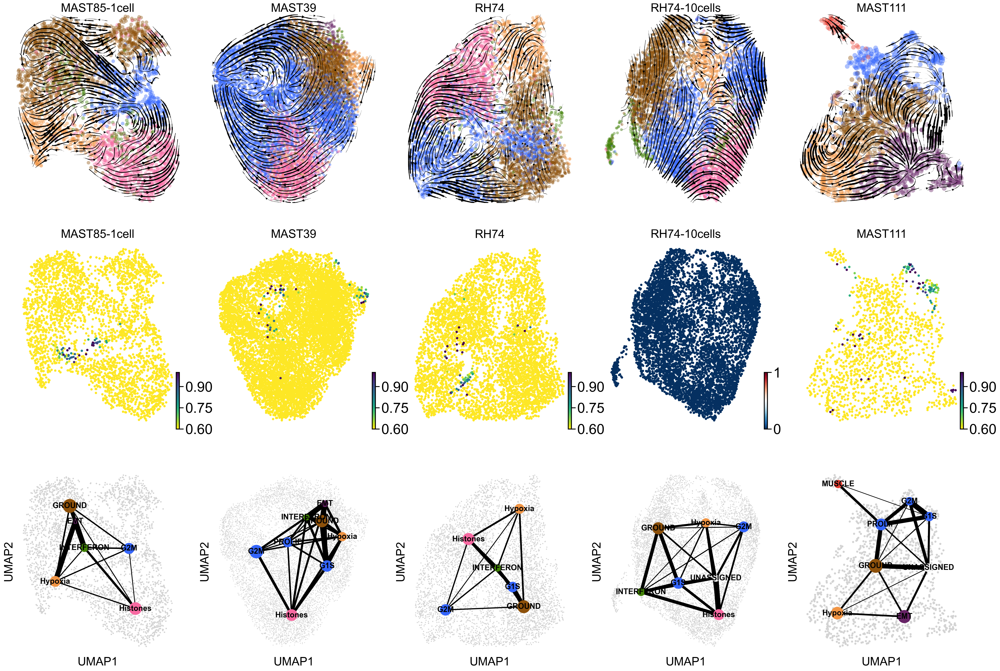

In [54]:
fig

In [57]:
fig.savefig("SuppFig4A.png", dpi=200)

In [30]:
cluster_annotation = pd.read_table('color_table.xls')
orders = ["GROUND", "Hypoxia", "EMT", "G1S", "UNASSIGNED", "G2M", "MUSCLE", "INTERFERON", "PROLIF", "Histones"]
cluster_annotation
label_stat = {}

for cutoff in [0.6]:
    arr = np.zeros((len(orders), len(glob('../results/*h5ad')[:-3])))
    arr[:] = np.nan
    df = pd.DataFrame(arr, 
                      columns=orders,
                      index=list(map(lambda x:os.path.basename(x).split('_')[0], glob('../results/*h5ad')[:-3])))
    for g in glob('../results/*h5ad')[:-3]:
        mast111 = sc.read(g)
        print(g)
        label = os.path.basename(g).split('_')[0]
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
        test_seu = r('readRDS')(seurat[0])
        with localconverter(ro.default_converter + pandas2ri.converter):
            meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
        #         meta = pandas2ri.ri2py(test_seu.slots['meta.data'])
        selection = np.load(f'../results/{label}_velocity.npy')
        clusters = meta.loc[selection, 'RNA_snn_res.0.8']
        print(clusters.unique())
        print(np.sum(mast111.obs.root_cells))
        tmp = pd.crosstab(mast111.obs.root_cells>cutoff, clusters.values)
        print(tmp)
        if tmp.shape[0] == 2:
            df.loc[label, cluster_annotation.loc[:, label].dropna()] = tmp.iloc[1, :].values/tmp.sum(axis=0).values
        else:
            df.loc[label, cluster_annotation.loc[:, label].dropna()] = np.nan
    label_stat[cutoff] = df

../results/MSK82489_velocity.h5ad
[0, 4, 5, 2, 1, 3, 6]
Categories (7, object): [0, 4, 5, 2, 1, 3, 6]
17.07248593980389
col_0         0   1   2   3   4   5  6
root_cells                            
False       108  17  92  40  76  55  3
True          3  14   0   0   0   1  4
../results/RH74-10cells_velocity.h5ad
[5, 8, 1, 0, 2, ..., 6, 4, 7, 10, 9]
Length: 11
Categories (11, object): [5, 8, 1, 0, ..., 4, 7, 10, 9]
0.0
col_0          0     1     2     3    4    5    6    7    8   9   10
root_cells                                                          
False       1271  1328  1249  1009  594  744  557  195  249  25  100
../results/MAST111_velocity.h5ad
[2, 1, 0, 3, 8, 7, 5, 6, 4]
Categories (9, object): [2, 1, 0, 3, ..., 7, 5, 6, 4]
123.6413489543564
col_0         0    1    2    3   4   5   6   7   8
root_cells                                        
False       411  275  267  214  32  56  21  58  40
True          9    6    2    2  47   0  31   4   6
../results/MAST35_velocity.h5ad
[2

In [31]:
np.quantile(label_stat[0.6].melt().dropna().value, 0.6)

0.026749826749826747

In [32]:
results = label_stat[0.6]
results = results[results>=0.0267]

In [33]:
results.to_csv("root_cells_human_velocity.csv")

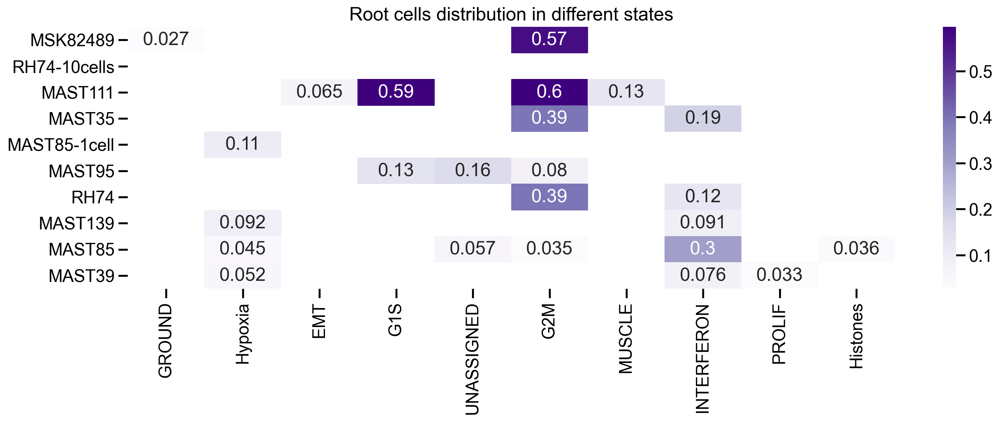

In [34]:
import seaborn as sns
sns.set_context('talk', font_scale=1)

for cutoff in [0.6]:
    plt.figure(figsize=(15, 6))
    sns.heatmap(results, cmap=plt.cm.Purples,
                annot=True,  cbar=True)
    plt.title('Root cells distribution in different states')
    plt.tight_layout()
    plt.savefig('starting_points_human_velocity%s_normalized_row.pdf' % cutoff)

In [35]:
import seaborn as sns
!ls ../results/*h5ad

../results/MAST111_velocity.h5ad       ../results/MSK82489_velocity.h5ad
../results/MAST139_velocity.h5ad       ../results/RH74-10cells_velocity.h5ad
../results/MAST35_velocity.h5ad        ../results/RH74_velocity.h5ad
../results/MAST39_velocity.h5ad        ../results/Tumor21_velocity.h5ad
../results/MAST85-1cell_velocity.h5ad  ../results/Tumor22_velocity.h5ad
../results/MAST85_velocity.h5ad        ../results/Tumor24_velocity.h5ad
../results/MAST95_velocity.h5ad


../results/MSK82489_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Hypoxia', 'MUSCLE'], dtype='object')


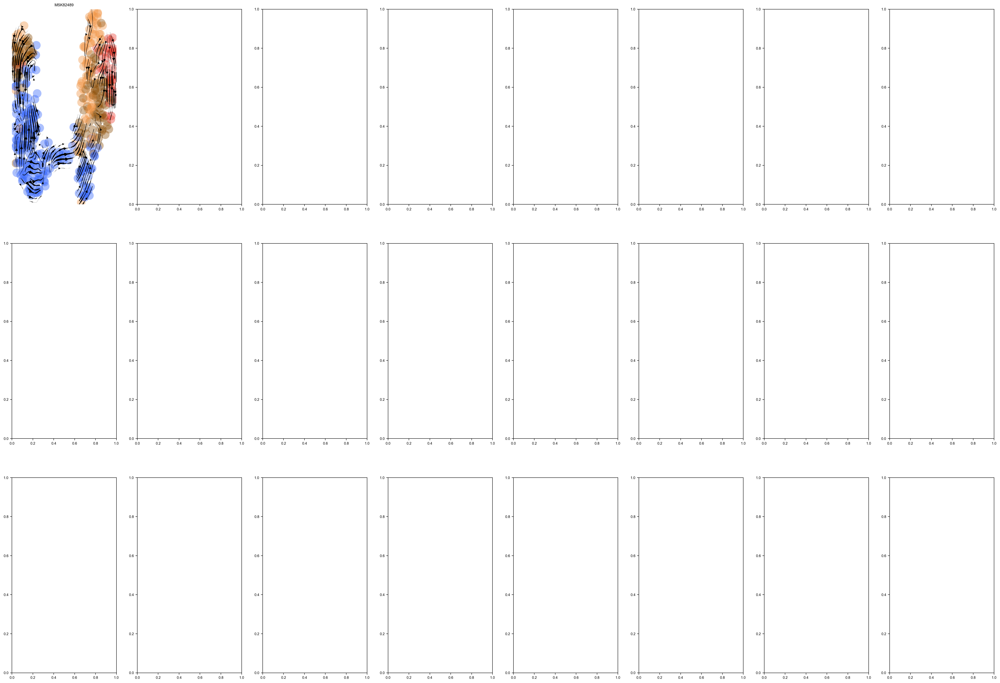

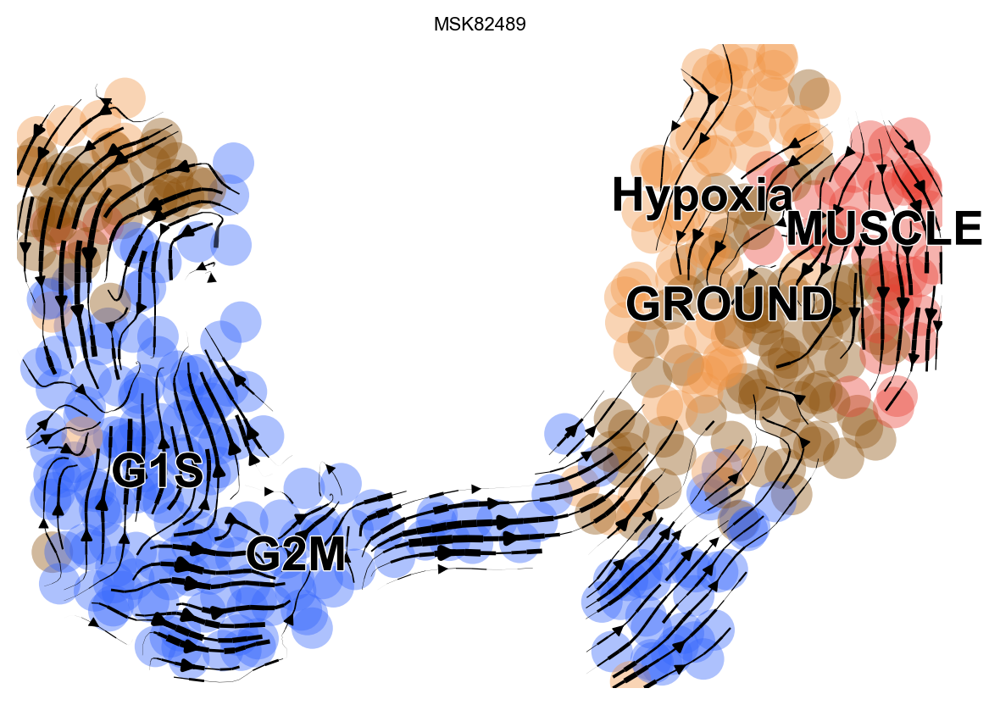

../results/MAST95_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Hypoxia', 'MUSCLE', 'UNASSIGNED'], dtype='object')


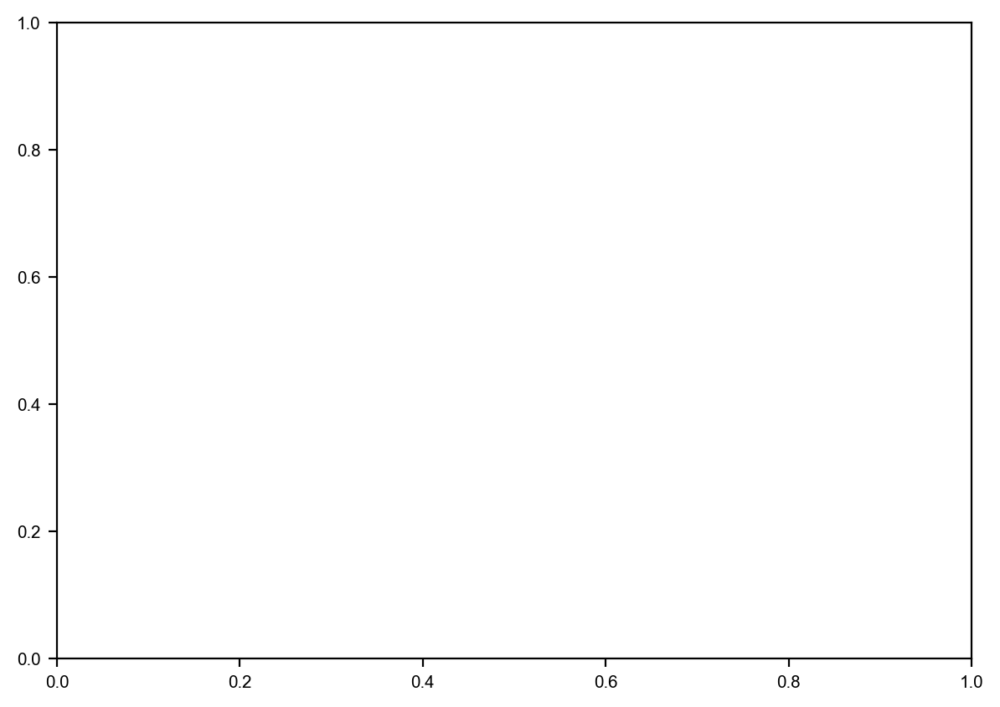

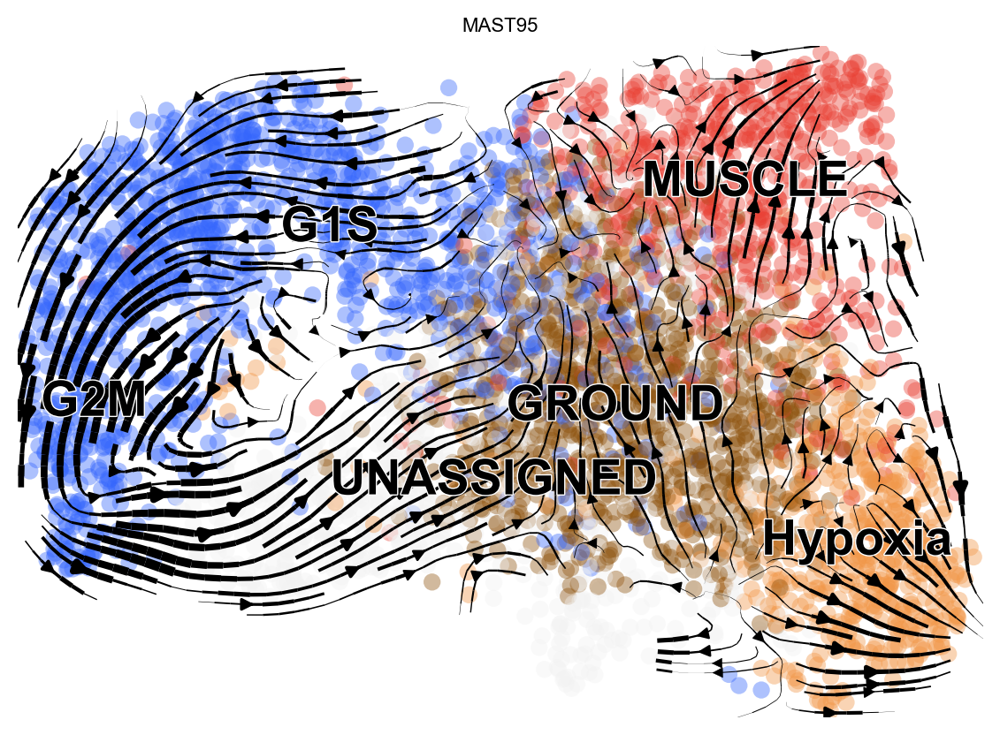

../results/MAST139_velocity.h5ad


... storing 'clusters' as categorical


Index(['EMT', 'G1S', 'G2M', 'GROUND', 'Hypoxia', 'INTERFERON', 'MUSCLE'], dtype='object')


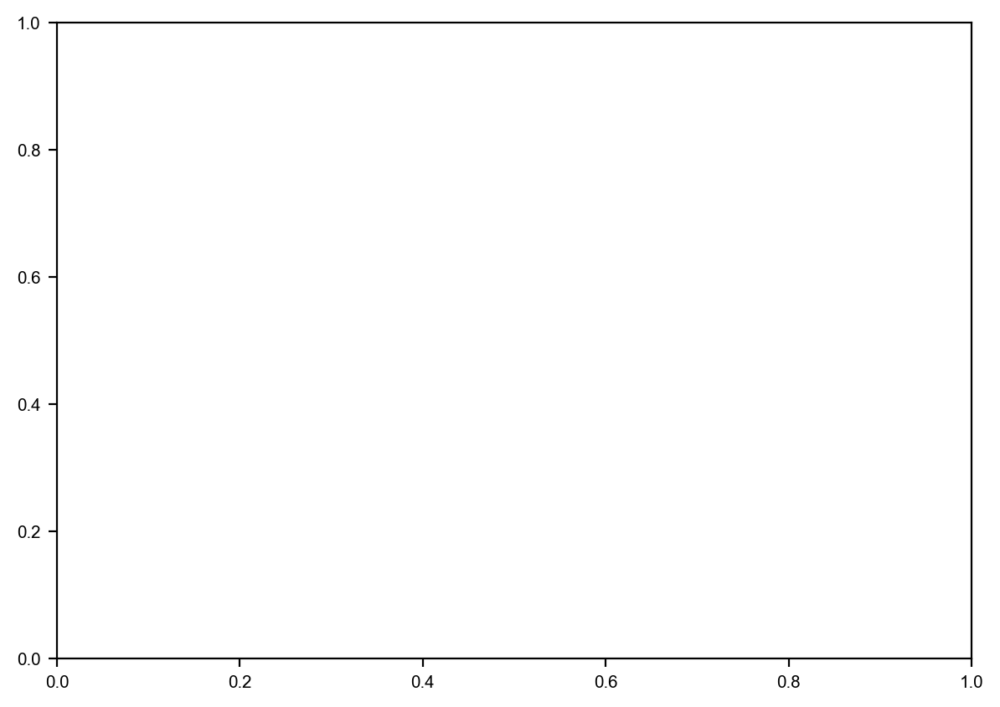

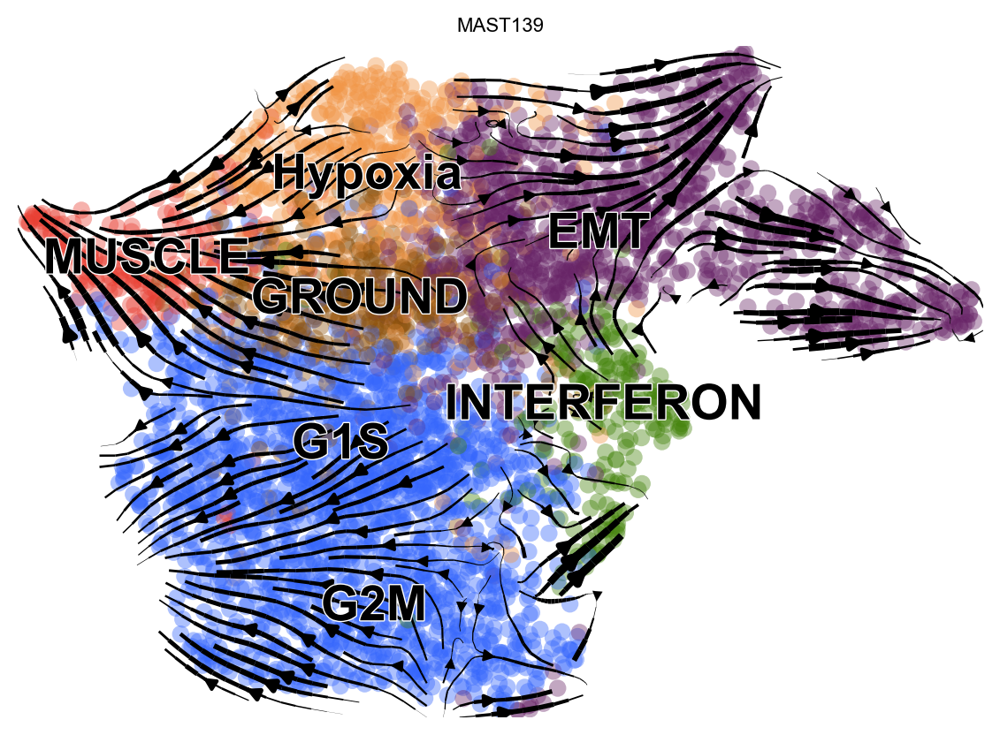

../results/MAST35_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON'], dtype='object')


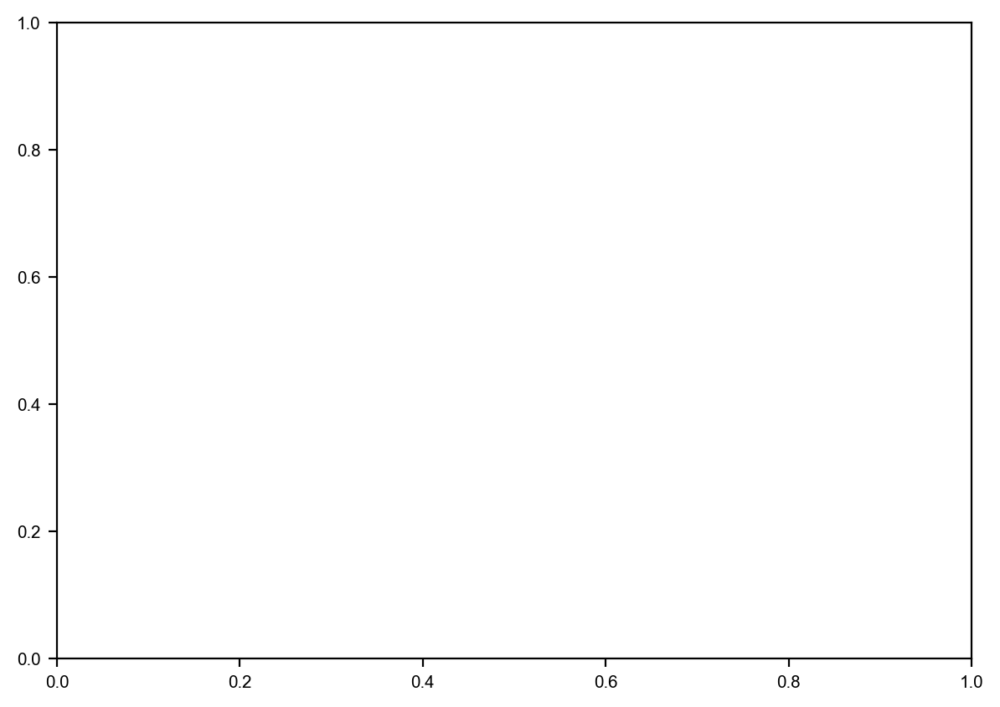

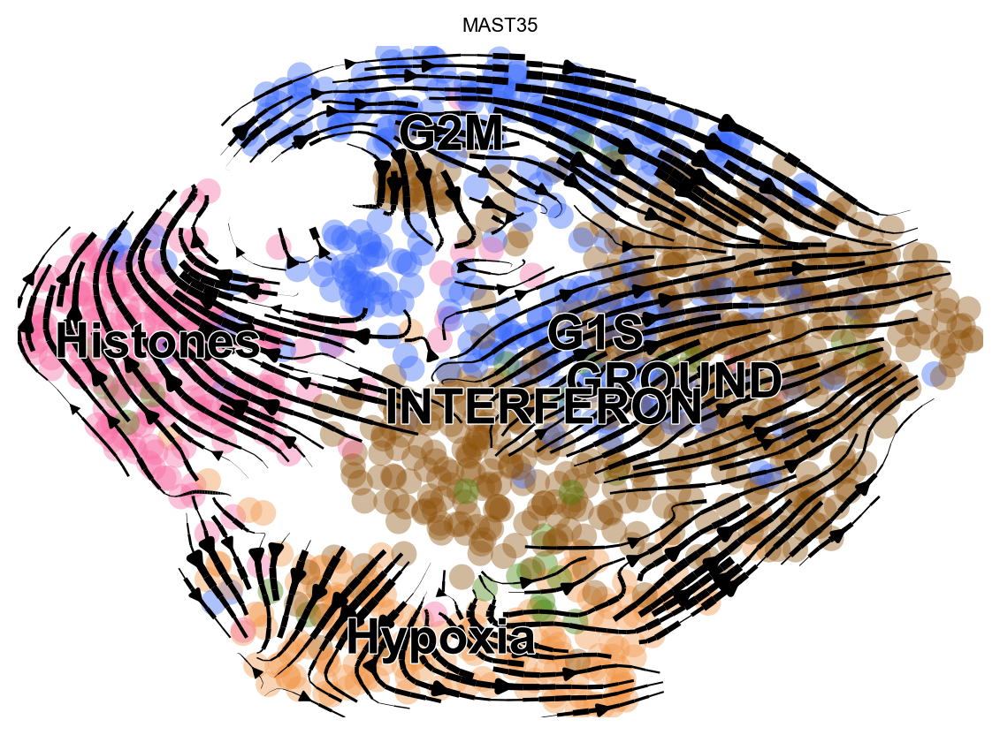

../results/MAST85_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON',
       'UNASSIGNED'],
      dtype='object')


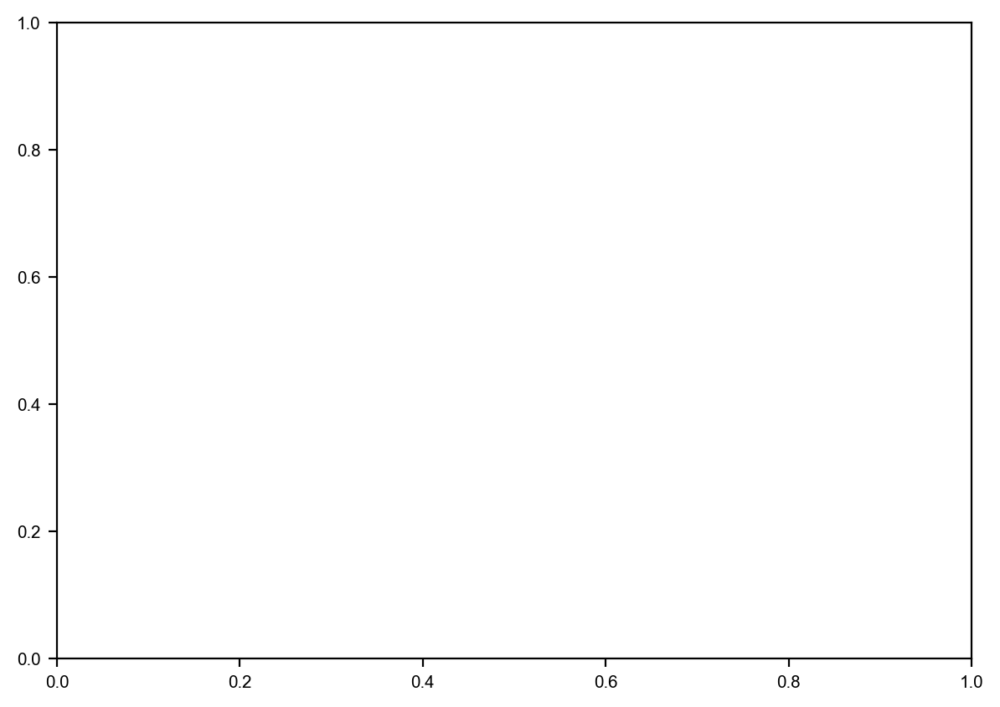

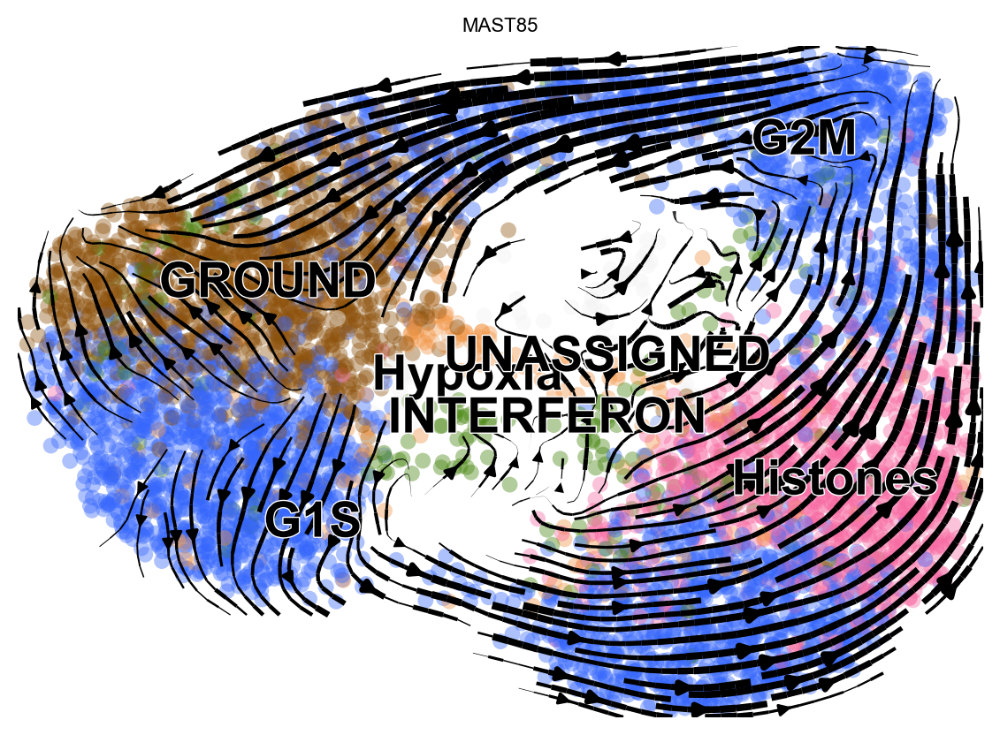

../results/MAST39_velocity.h5ad


... storing 'clusters' as categorical


Index(['EMT', 'G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON',
       'PROLIF'],
      dtype='object')


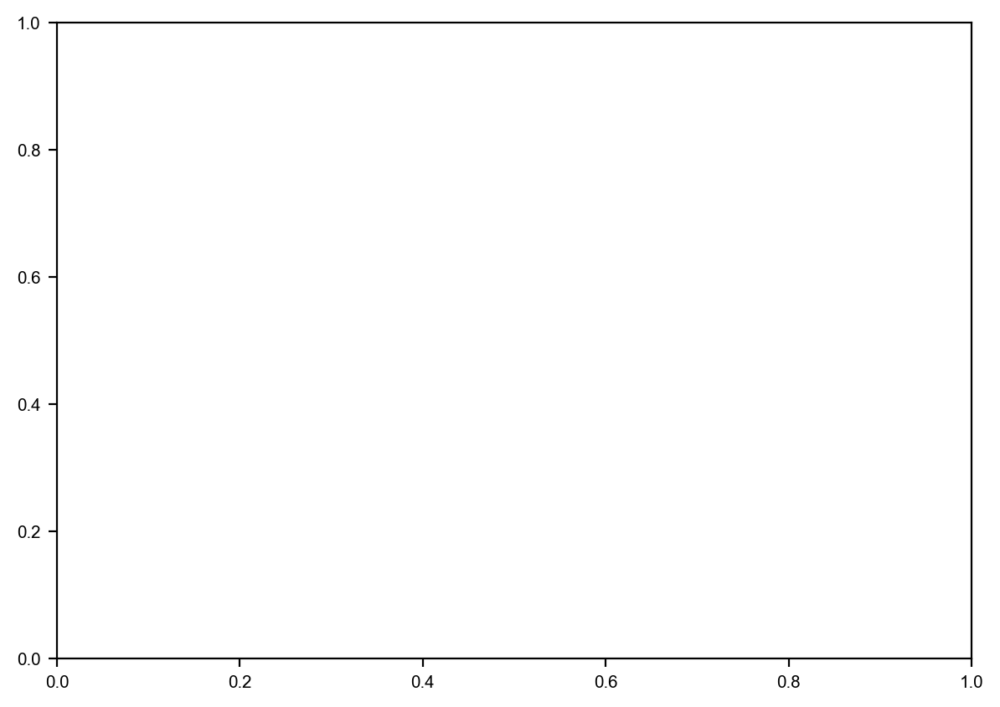

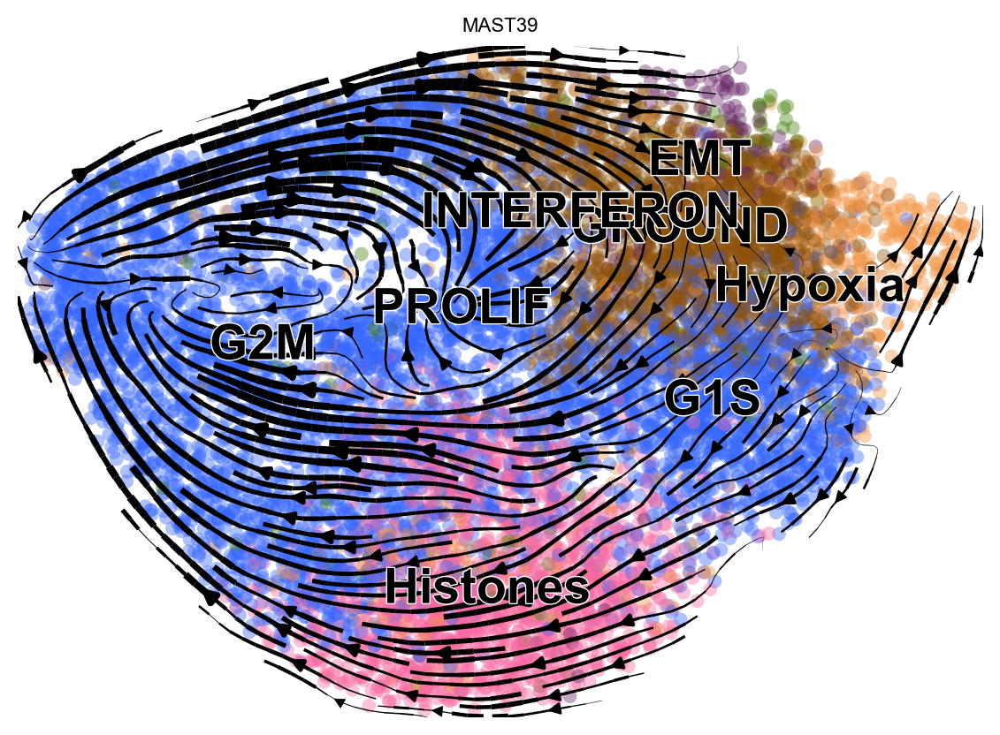

../results/RH74_velocity.h5ad


... storing 'clusters' as categorical


Index(['G1S', 'G2M', 'GROUND', 'Histones', 'Hypoxia', 'INTERFERON'], dtype='object')


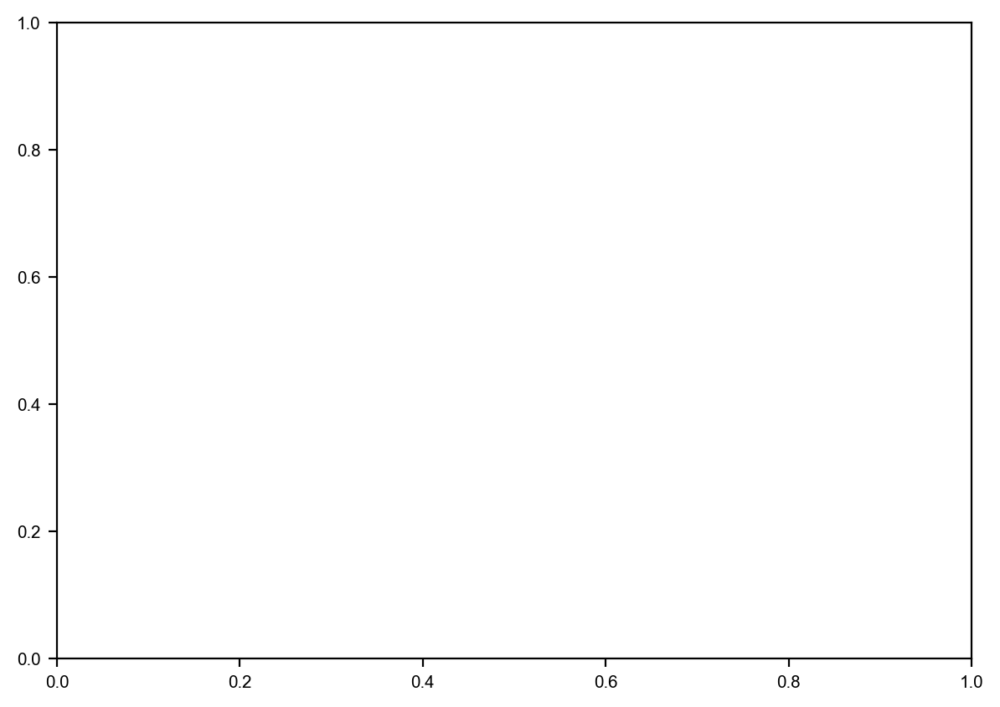

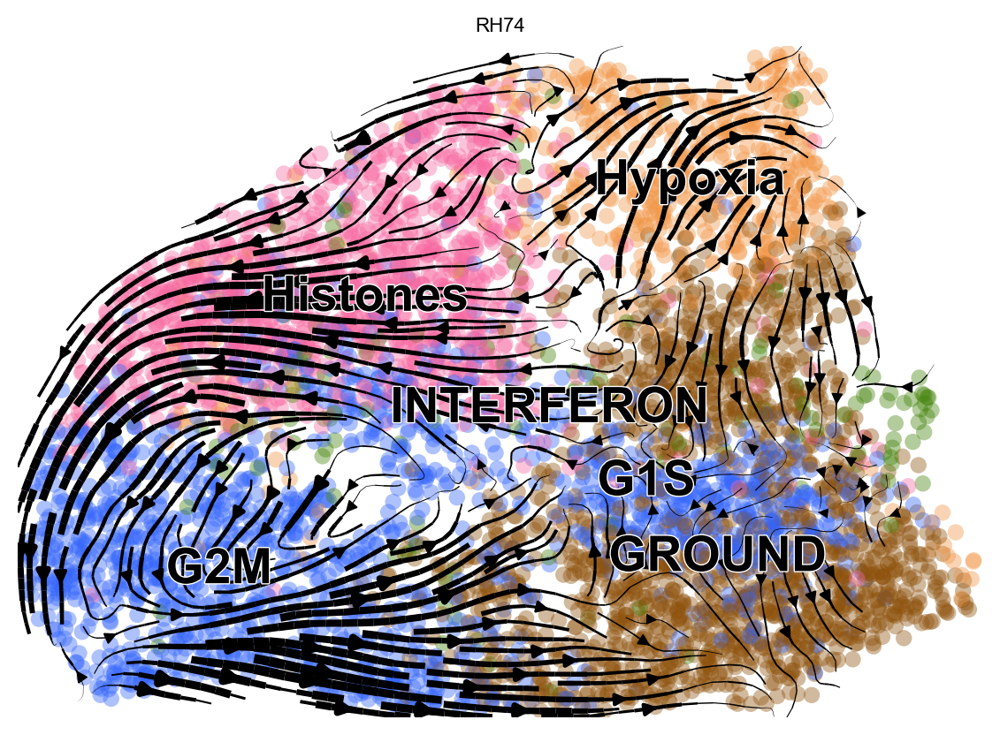

../results/MAST111_velocity.h5ad


... storing 'clusters' as categorical


Index(['EMT', 'G1S', 'G2M', 'GROUND', 'Hypoxia', 'MUSCLE', 'PROLIF',
       'UNASSIGNED'],
      dtype='object')


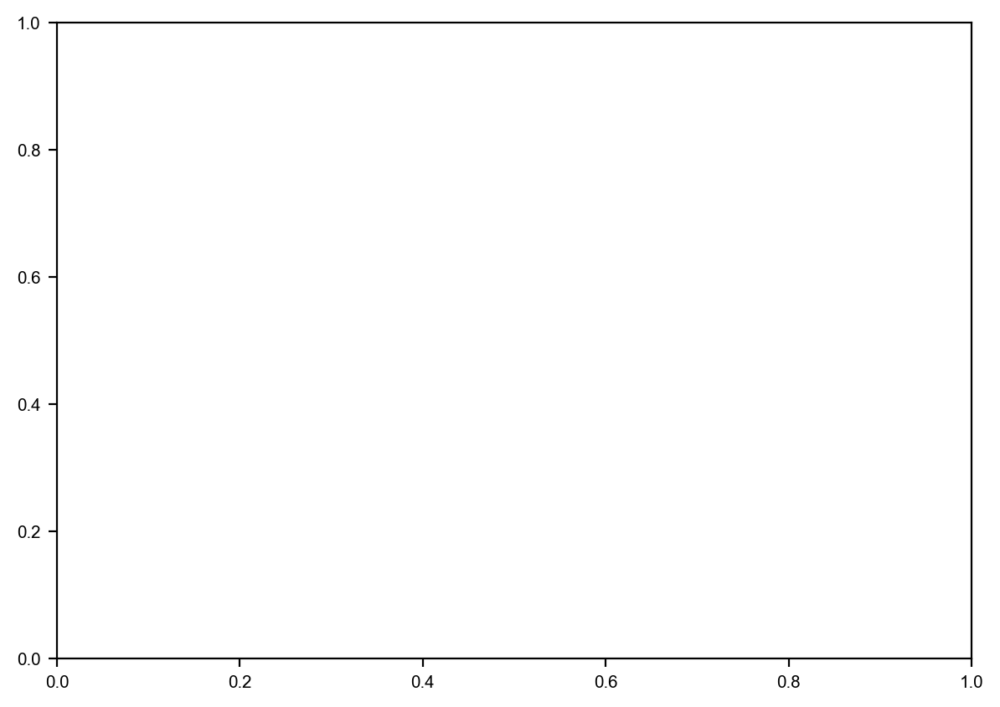

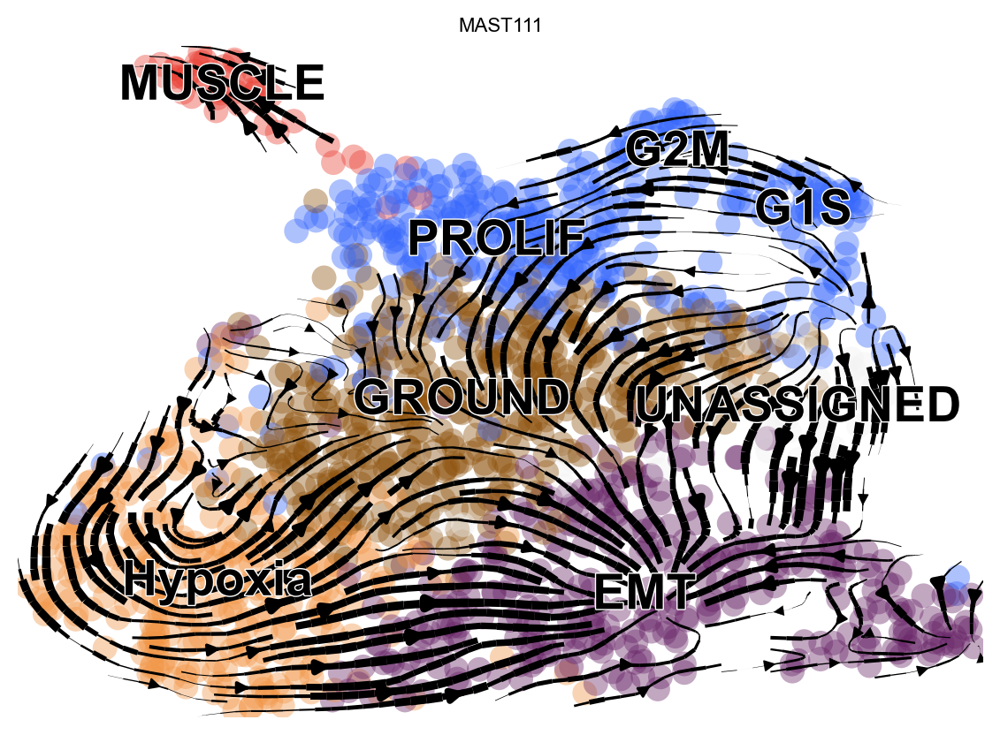

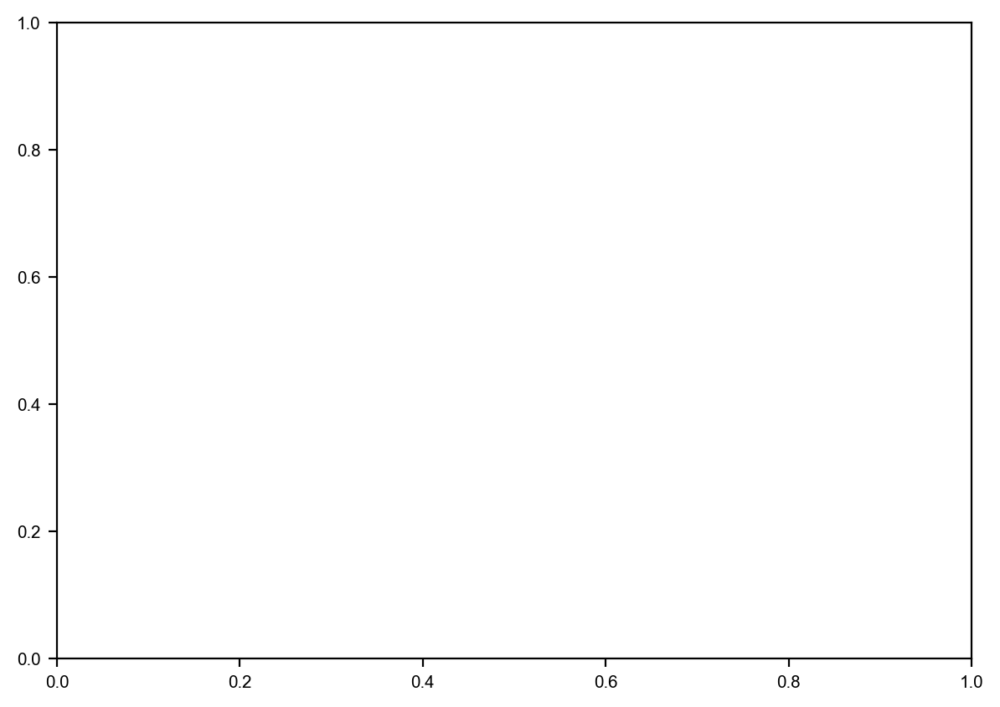

In [10]:
import scipy, igraph
degrees = []
label_stat = {}
fig, axes = plt.subplots(3, 8)
fig.set_size_inches(36, 25)
col = 0
row = 0
# '../results/MAST35_velocity.h5ad', 
#           '../results/MAST85_velocity.h5ad', 
#           '../results/MAST85-1cell_velocity.h5ad',
for g in ['../results/MSK82489_velocity.h5ad',
          '../results/MAST95_velocity.h5ad',
          '../results/MAST139_velocity.h5ad',
          '../results/MAST35_velocity.h5ad',
          '../results/MAST85_velocity.h5ad',
          '../results/MAST39_velocity.h5ad',
          '../results/RH74_velocity.h5ad', 
          '../results/MAST111_velocity.h5ad']:
    mast111 = sc.read(g)
    print(g)
    label = os.path.basename(g).split('_')[0]
    
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
    selection = np.load(f'../results/{label}_velocity.npy')
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    
    metalabels = np.array(["GROUND", "Hypoxia", "EMT", "G1S", "UNASSIGNED", "G2M", 
                           "MUSCLE", "INTERFERON", "PROLIF", "Histones"])
    metacolors = np.array(["#8D510B", "#F19545", "#672366", "#3465FC", "#F2F2F2",
                           "#3465FC", "#E93F33", "#418107", "#3465FC", "#F769A1"])
    
    colortab = pd.read_table('color_table.xls')    
    color_dict = {}
    color_dict2 = {}
    metalabels_dict = {}
    for i, m in enumerate(metalabels):
        metalabels_dict[m] = i
    colors = np.array([ metalabels_dict[m] for m in colortab.loc[:, label].dropna() ])
    for i, j, c in zip(range(len(colortab.loc[:, label].dropna())), 
                       colortab.loc[:, label].dropna(), 
                       metacolors[colors]):
        color_dict[str(i)] = j
        color_dict2[j] = c
    mast111.obs['clusters'] = clusters.values.map(color_dict)

    sc.tl.paga(mast111)
    sc.tl.paga(mast111, groups='clusters', use_rna_velocity=False)

#    clusters.values   
    mast111.uns['clusters_colors'] = [color_dict2[c] for c in mast111.obs['clusters'].cat.categories]
    
    print(mast111.obs['clusters'].cat.categories)
    if col == 10:
        row = 1
        col = 0
#         break
#     scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
#                                      legend_fontsize=20, alpha=.4, show=False,
#                                      arrow_color='gray',
#                                      linewidth=2, legend_loc=None,
#                                      ax=axes[row, col])
#     scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
#                    size=100, legend_fontsize=40,
#                    show=False, ax=axes[row+1, col])
# #     sc.pl.paga(mast111, color=['clusters'], edge_width_scale=0.5, 
# #                layout='fr', random_state=0, frameon=False, title=label,
# #                fontsize=20, threshold=0.1, show=False, ax=axes[row+2, col])
#     paga_compare(
#         mast111, title='',  threshold=0.1, right_margin=0.2, size=20, edge_width_scale=1,
#         legend_fontsize=20, fontsize=20, frameon=False, show=False, ax=axes[row+2, col])
    
    scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                     legend_fontsize=20, alpha=.4, show=False,
                                     legend_loc='none',
                                     linewidth=2,
                                     ax=axes[row, col])
    scv.pl.velocity_embedding_stream(mast111, basis='umap', color=['clusters'], title=label,
                                     legend_fontsize=20, alpha=.4, show=True,
                                     linewidth=2)   
    
    if g != '../results/RH74-10cells_velocity.h5ad':
        scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
                       size=100, legend_fontsize=40, fontsize=40,        
                       vmin=0.6, vmax=1.0, 
                       show=False, ax=axes[row+1, col])
    else:
        scv.pl.scatter(mast111, basis='umap', color=['root_cells'], title=label,
                       size=100, legend_fontsize=40, fontsize=40,        
                       vmin=0, vmax=1.0, 
                       show=False, ax=axes[row+1, col])        
# #     sc.pl.paga(mast111, color=['clusters'], edge_width_scale=0.5, 
# #                layout='fr', random_state=0, frameon=False, title=label,
# #                fontsize=20, threshold=0.1, show=False, ax=axes[row+2, col])
    paga_compare(mast111, title='', legend_loc='none', threshold=0.1, 
                 right_margin=0.2, size=20, edge_width_scale=1,
                 legend_fontsize=None, frameon=False, show=False, ax=axes[row+2, col])
    
    col += 1
#     break
    conn = scipy.sparse.csr_matrix.todense(mast111.uns['paga']['connectivities'])
    g = igraph.Graph.Adjacency((conn>0.1).tolist())
#     degrees.append(igraph.Graph.indegree(g))
    g.es['weight'] = conn[conn.nonzero()]
    g.vs['label']  = mast111.obs['clusters'].cat.categories
    
    degree_dict = {}
    for c, d in zip(mast111.obs['clusters'].cat.categories, igraph.Graph.indegree(g)):
        degree_dict[c] = d
    degrees.append(degree_dict)
    
for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(25)

In [11]:
degrees

[{'G1S': 4, 'G2M': 3, 'GROUND': 4, 'Hypoxia': 4, 'MUSCLE': 3},
 {'G1S': 4, 'G2M': 2, 'GROUND': 4, 'Hypoxia': 3, 'MUSCLE': 4, 'UNASSIGNED': 5},
 {'EMT': 4,
  'G1S': 6,
  'G2M': 4,
  'GROUND': 6,
  'Hypoxia': 6,
  'INTERFERON': 5,
  'MUSCLE': 3},
 {'G1S': 3,
  'G2M': 4,
  'GROUND': 4,
  'Histones': 4,
  'Hypoxia': 4,
  'INTERFERON': 5},
 {'G1S': 5,
  'G2M': 5,
  'GROUND': 5,
  'Histones': 5,
  'Hypoxia': 6,
  'INTERFERON': 5,
  'UNASSIGNED': 5},
 {'EMT': 6,
  'G1S': 6,
  'G2M': 5,
  'GROUND': 6,
  'Histones': 6,
  'Hypoxia': 7,
  'INTERFERON': 7,
  'PROLIF': 7},
 {'G1S': 3,
  'G2M': 4,
  'GROUND': 4,
  'Histones': 4,
  'Hypoxia': 4,
  'INTERFERON': 5},
 {'EMT': 3,
  'G1S': 5,
  'G2M': 4,
  'GROUND': 6,
  'Hypoxia': 3,
  'MUSCLE': 2,
  'PROLIF': 5,
  'UNASSIGNED': 6}]

In [ ]:
categories = []
for i in degrees:
    categories += list(i.keys())
categories = list(set(categories))

In [70]:
categories

['UNASSIGNED', 'G1S', 'PROLIF', 'Hypoxia', 'MUSCLE', 'EMT', 'G2M', 'GROUND']

In [68]:
degree_names = []
labels = list(map(lambda x: os.path.basename(x).split('_')[0],  ['../results/MSK82489_velocity.h5ad',
          '../results/MAST95_velocity.h5ad',
          '../results/MAST139_velocity.h5ad',
          '../results/MAST35_velocity.h5ad',
          '../results/MAST85_velocity.h5ad',
          '../results/MAST39_velocity.h5ad',
          '../results/RH74_velocity.h5ad', 
          '../results/MAST111_velocity.h5ad']))
print(labels)

degree_df = []
states = []
for d, l in zip(degrees, labels):
    degree_df += categories
    states += [d.get(c, 0) for c in categories]
    degree_names += [l] * len(categories)
    
degree_df = pd.DataFrame({'samples': degree_names, 
                          'states': degree_df,
                          'degrees': states})

['MSK82489', 'MAST95', 'MAST139', 'MAST35', 'MAST85', 'MAST39', 'RH74', 'MAST111']


In [64]:
degree_df.head()

,samples,states,degrees
0,MSK82489,UNASSIGNED,NaN
1,MSK82489,G1S,4.0
2,MSK82489,PROLIF,NaN
3,MSK82489,Hypoxia,4.0
4,MSK82489,MUSCLE,3.0


In [43]:
degree_df.to_csv('Fig3D.csv')

In [66]:
degree_df.states = degree_df.states.astype('category')
degree_df.samples = degree_df.samples.astype('category')

In [53]:
catdict = {}
categories = list(degrees[5].keys())
for i, j in enumerate(categories):
    catdict[j] = i

In [69]:
## line is disordered perhaps is caused by bugs.... not suitable for plotting multiple rader, use go interface
import plotly.express as px
import pandas as pd
fig = px.line_polar(degree_df, r='degrees',  #.loc[degree_df.samples=='MAST85', :]
                    theta='states', category_orders=catdict, color='samples', line_close=True)
fig.show()

#  {'G1S': 5,
#   'G2M': 5,
#   'GROUND': 5,
#   'Histones': 5,
#   'Hypoxia': 6,
#   'INTERFERON': 5,
#   'UNASSIGNED': 5}

In [46]:
import igraph
import scipy
conn = scipy.sparse.csr_matrix.todense(mast111.uns['paga']['connectivities'])
g=igraph.Graph.Adjacency((conn>0.2).tolist())
g.es['weight'] = conn[conn.nonzero()]
g.vs['label']  = mast111.obs['clusters'].cat.categories
#degrees.append(igraph.Graph.indegree(g))

In [47]:
list(zip(mast111.obs['clusters'].cat.categories, 
         igraph.Graph.indegree(g)))

[('EMT', 3),
 ('G1S', 3),
 ('G2M', 3),
 ('GROUND', 4),
 ('Hypoxia', 2),
 ('MUSCLE', 1),
 ('PROLIF', 5),
 ('UNASSIGNED', 5)]